<a href="https://colab.research.google.com/github/gabrielvime/initial-challenge-semantic-segmentation/blob/main/pistas_v2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Dataset para download: https://drive.google.com/file/d/1B3ag5kWrjg6aTiYQ2izRlwb-vehwFpqi/view?usp=sharing

Cheksum: 944964916e4e01d7b8946d3bb1c9b0680806b06319a92a8c25666bb4257fc538

\
Para utilizar este notebook e treinar o modelo basta baixar o dataset disponibilizado, salva-lo no seu Google Drive, configurar o diretorio, autenticar com a API do Earth Engine e clicar em ```Run all```.

\
Para fazer autenticação com suas credenciais do Google Cloud e utilizar a api do Earth Engine, acesse o [API Console](https://console.developers.google.com/). Em caso de dúvidas, acesse a documentação aficial [aqui](https://support.google.com/googleapi/answer/7014113).

\
Se quiser, você pode pular a parte de treino e utilizar o arquivo de modelo já treinado que está disponível, apesar de não ser recomendado.

\
ATENÇÃO: Por padrão o Colab utiliza aceleração por CPU, porém, treinar modelos com CPU é extremamente demorado. Recomenda-se alterar para aceleração por GPU. O Google disponibiliza GPUs T4 gratuitamente (apesar de limitado).
Para alterar, clique em ```Runtime > Change runtime type``` e selecione ```T4 GPU``` ou outra caso tenha algum plano premium.

\
Observação: Este código não está configurado para utilizar TPUs. Saiba mais clicando [aqui](https://docs.cloud.google.com/tpu/docs/intro-to-tpu).

## CONFIGURAR GOOGLE DRIVE

In [2]:
from google.colab import drive

drive.mount('/content/drive')

# ATENCAO
#ALTERE COM O CAMINHO ONDE ESTA SALVO O DATASET
DATA_DIR = '/content/drive/MyDrive/S2_dataset'

Mounted at /content/drive


## Autenticar GEE

In [ ]:
import ee

ee.Authenticate()

# NAO ESQUECA DE ALTERAR COM O SEU Project ID
ee.Initialize(project='seu-projeto-123456')

## Imports

In [1]:
!pip install segmentation_models_pytorch

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import segmentation_models_pytorch as smp
import numpy as np
import rasterio
from tqdm import tqdm
import matplotlib.pyplot as plt
import glob
import os
from scipy.ndimage import binary_opening, binary_closing

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.8/154.8 kB 3.6 MB/s eta 0:00:00


## PyTorch Dataset

In [3]:
class PyTorchDataset(Dataset):

    # Dataset que carrega imagens de satelite e suas mascaras.
    # Cada imagem tem:
    # 8 bandas espectrais (RGB + NIR + SWIR + NDVI + FNBI)
    # 1 mascara (1 = pista, 0 = background)


    def __init__(self, image_paths):
        self.image_paths = image_paths

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):

        # Ler arquivo GeoTIFF
        with rasterio.open(self.image_paths[idx]) as src:
            data = src.read()  # Shape: (9, 256, 256)

        # Separar imagem e mascara
        image = data[:-1]  # Primeiras 8 bandas
        mask = data[-1]    # Última banda

        # Normalizar imagem (colocar valores entre 0 e 1)
        image_normalized = []
        for band in image:

            # Usar percentis para normalização
            p1 = np.percentile(band, 1)
            p99 = np.percentile(band, 99)
            band_norm = (band - p1) / (p99 - p1 + 0.00001)
            band_norm = np.clip(band_norm, 0, 1)
            image_normalized.append(band_norm)

        image = np.stack(image_normalized)

        # Converter para tensores PyTorch
        image = torch.FloatTensor(image)
        mask = torch.FloatTensor(mask).unsqueeze(0)  # Adicionar dimensão

        return image, mask


ARQUIVOS DE TREINO E VALIDAÇÃO

In [4]:
train_images = glob.glob(os.path.join(DATA_DIR, 'train', '*.tif'))
val_images = glob.glob(os.path.join(DATA_DIR, 'val', '*.tif'))


print(' DADOS CARREGADOS')
print()
print(f' Treino: {len(train_images)}')
print(f' Validação: {len(val_images)}')


# Criar datasets
train_dataset = PyTorchDataset(train_images)
val_dataset = PyTorchDataset(val_images)

# Criar dataloaders (carregam dados em batches)
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

DADOS CARREGADOS

Treino: 106
Validação: 23


## DEFINIR MODELO

In [48]:
# Usar GPU se disponível, senao CPU
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f'\n Usando: {device}')

# Modelo U-Net com MiT_b2
model = smp.Unet(
    encoder_name='mit_b2',    # Backbone
    encoder_weights=None,
    in_channels=8,              # 8 bandas de entrada
    classes=1                   # 1 classe de saida (pista)
)

model = model.to(device)

print(' Modelo criado')


Usando: cpu
Modelo criado


## LOSS E OTIMIZADOR

In [60]:
# Binary Cross Entropy com camada Sigmoid
pos_weight = torch.tensor([100.0])  # Dar muito mais peso para pixels de pista
criterion = nn.BCEWithLogitsLoss(pos_weight=pos_weight.to(device))

# Otimizador: Adam
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

print(' Loss e otimizador configurados')

 Loss e otimizador configurados


## TREINA UMA EPOCA

In [36]:
def train_one_epoch(model, dataloader, criterion, optimizer, device):

  #Treina o modelo por uma epoca

  model.train()  # Modo treino
  total_loss = 0

  # Barra de progresso
  pbar = tqdm(dataloader, desc='Treinando...')

  for images, masks in pbar:
    # Mover dados para GPU/CPU
    images = images.to(device)
    masks = masks.to(device)

    # Zerar gradientes anteriores
    optimizer.zero_grad()

    # Fazer predição
    predictions = model(images)

    # Calcular erro (loss)
    loss = criterion(predictions, masks)

    # Calcular gradientes (backpropagation)
    loss.backward()

    # Atualizar pesos
    optimizer.step()

    # Acumular loss
    total_loss += loss.item()

    # Atualizar barra de progresso
    pbar.set_postfix({'loss': f'{loss.item():.4f}'})

  # Retornar loss media
  return total_loss / len(dataloader)

## FUNÇÃO DE VALIDAÇÃO

In [35]:
def validate(model, dataloader, criterion, device):

  #Avalia o modelo nos dados de validacao

  model.eval()  # Modo avaliacao
  total_loss = 0
  total_dice = 0

  with torch.no_grad():  # Nao calcular gradientes para ser mais rápido
    pbar = tqdm(dataloader, desc='Validando')

    for images, masks in pbar:
        images = images.to(device)
        masks = masks.to(device)

        # Fazer predicao
        predictions = model(images)

        # Calcular loss
        loss = criterion(predictions, masks)
        total_loss += loss.item()

        # Calcular Dice Score
        pred_binary = (torch.sigmoid(predictions) > 0.5).float()
        intersection = (pred_binary * masks).sum()
        dice = (2 * intersection) / (pred_binary.sum() + masks.sum() + 1e-6)
        total_dice += dice.item()

        pbar.set_postfix({'loss': f'{loss.item():.4f}', 'dice': f'{dice.item():.4f}'})

  # Retornar metricas medias
  avg_loss = total_loss / len(dataloader)
  avg_dice = total_dice / len(dataloader)

  return avg_loss, avg_dice

## TREINAMENTO

In [34]:
print()
print(" INICIANDO TREINAMENTO...")
print()

num_epochs = 100
best_dice = 0

# Historico para plotar depois
history = {'train_loss': [], 'val_loss': [], 'val_dice': []}

for epoch in range(num_epochs):
  print(f"\n Epoca {epoch+1}/{num_epochs}")
  print()

  # Treinar
  train_loss = train_one_epoch(model, train_loader, criterion, optimizer, device)

  # Validar
  val_loss, val_dice = validate(model, val_loader, criterion, device)

  # Guardar historico
  history['train_loss'].append(train_loss)
  history['val_loss'].append(val_loss)
  history['val_dice'].append(val_dice)

  # Mostrar resultados
  print(f"\nResultados:")
  print(f"  Train Loss: {train_loss:.4f}")
  print(f"  Val Loss:   {val_loss:.4f}")
  print(f"  Val Dice:   {val_dice:.4f}")

  # Salvar melhor modelo
  if val_dice > best_dice:
      best_dice = val_dice
      torch.save(model.state_dict(), 'melhor_modelo.pth')
      print(f' Novo melhor modelo salvo (Dice: {best_dice:.4f})')

print()
print(' TREINAMENTO COMPLETO')
print(f' Melhor Dice Score: {best_dice:.4f}')
print()



 INICIANDO TREINAMENTO...


 Epoca 1/100



Treinando...:   0%|          | 0/27 [00:05<?, ?it/s]


KeyboardInterrupt: 

## VISUALIZAÇÃO

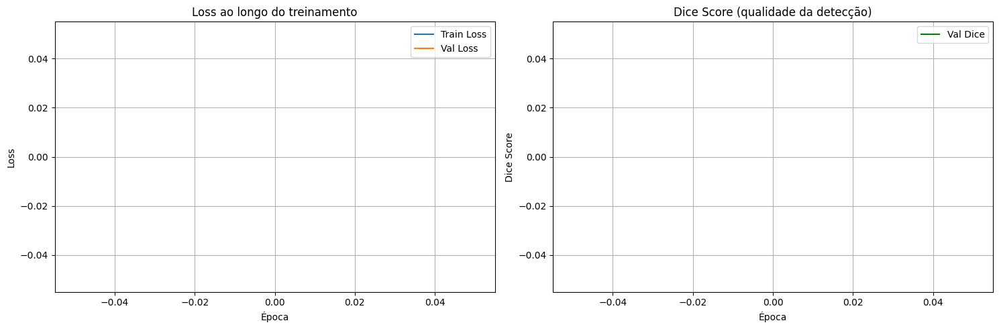


✓ Gráficos salvos em "resultados_treino.png"


In [37]:
plt.figure(figsize=(15, 5))

# Loss
plt.subplot(1, 2, 1)
plt.plot(history['train_loss'], label='Train Loss')
plt.plot(history['val_loss'], label='Val Loss')
plt.xlabel('Epoca')
plt.ylabel('Loss')
plt.title('Loss ao longo do treinamento')
plt.legend()
plt.grid(True)

# Dice
plt.subplot(1, 2, 2)
plt.plot(history['val_dice'], label='Val Dice', color='green')
plt.xlabel('Epoca')
plt.ylabel('Dice Score')
plt.title('Dice Score')
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.savefig('resultados_treino.png', dpi=150)
plt.show()

print('\n Graficos salvos em "resultados_treino.png"')


## PREDIÇÕES

cpu

VISUALIZANDO PREDIÇÕES



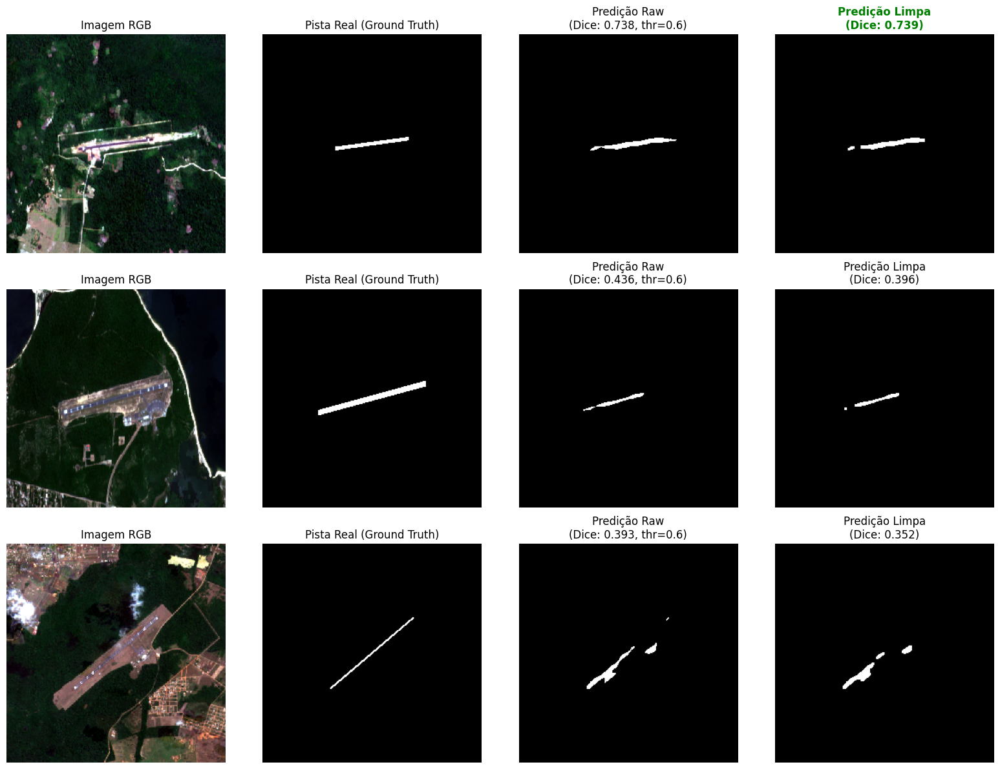


 Visualizacoes salvas em 'predicoes.png'
 Threshold=0.6 e pós-processamento


In [55]:
def clean_pred(pred_mask):

  #Remove ruído pequeno da predicao usando operacoes morfologicas

  # Remover pixels isolados (ruido)
  pred_limpa = binary_opening(pred_mask, structure=np.ones((3, 3)))

  # Fechar pequenos buracos
  pred_limpa = binary_closing(pred_limpa, structure=np.ones((5, 5)))

  return pred_limpa.astype(np.uint8)


def show_pred(model, dataset, device, num_exemplos=3, threshold=0.6):
  #Mostra predições do modelo

  model.eval()

  fig, axes = plt.subplots(num_exemplos, 4, figsize=(16, 4*num_exemplos))

  with torch.no_grad():
    for i in range(num_exemplos):

      # Pegar uma imagem
      image, mask = dataset[i]

      # Fazer predicao
      image_batch = image.unsqueeze(0).to(device)
      prediction = model(image_batch)

      pred_mask_raw = (torch.sigmoid(prediction) > threshold).squeeze().cpu().numpy()

      pred_mask_clean = clean_pred(pred_mask_raw)

      # Preparar imagem RGB para visualizar
      rgb = image[:3].permute(1, 2, 0).cpu().numpy()
      rgb = np.clip(rgb, 0, 1)

      mask_np = mask.squeeze().cpu().numpy()

      def calc_dice(pred, true):
          intersection = (pred * true).sum()
          return (2 * intersection) / (pred.sum() + true.sum() + 1e-6)

      dice_raw = calc_dice(pred_mask_raw, mask_np)
      dice_clean = calc_dice(pred_mask_clean, mask_np)

      # Plotar
      axes[i, 0].imshow(rgb)
      axes[i, 0].set_title('Imagem RGB')
      axes[i, 0].axis('off')

      axes[i, 1].imshow(mask_np, cmap='gray')
      axes[i, 1].set_title('Pista Real (Ground Truth)')
      axes[i, 1].axis('off')

      axes[i, 2].imshow(pred_mask_raw, cmap='gray')
      axes[i, 2].set_title(f'Predição Raw\n(Dice: {dice_raw:.3f}, thr={threshold})')
      axes[i, 2].axis('off')

      axes[i, 3].imshow(pred_mask_clean, cmap='gray')
      axes[i, 3].set_title(f'Predição Limpa\n(Dice: {dice_clean:.3f})',
                          color='green' if dice_clean > dice_raw else 'black',
                          fontweight='bold' if dice_clean > dice_raw else 'normal')
      axes[i, 3].axis('off')

  plt.tight_layout()
  plt.savefig('predicoes.png', dpi=150)
  plt.show()

  print("\n Visualizacoes salvas em 'predicoes.png'")
  print(f" Threshold={threshold} e pós-processamento")

# Carregar melhor modelo
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.load_state_dict(torch.load('modelo.pth', device))

# Visualizar
print()
print("VISUALIZANDO PREDIÇÕES")
print()

show_pred(model, val_dataset, device, num_exemplos=3, threshold=0.6)


## TESTES

In [31]:
def show_results(patch_path, model, device='cuda' if torch.cuda.is_available() else 'cpu', threshold=0.5):

  #Visualiza predição em um patch

  # Ler patch
  with rasterio.open(patch_path) as src:
      arr = src.read()

  # Separar ground truth e bandas
  y_true = arr[-1]  # Última banda = máscara
  x = arr[:-1]      # Demais bandas

  # Normalizar (mesmo do treino)
  x_norm = []
  for c in range(x.shape[0]):
      ch = x[c]
      p1, p99 = np.percentile(ch, 1), np.percentile(ch, 99)
      ch = np.clip((ch - p1) / (p99 - p1 + 1e-6), 0, 1)
      x_norm.append(ch)
  x_norm = np.stack(x_norm, axis=0)

  # Preparar para modelo
  x_tensor = torch.from_numpy(x_norm).float().unsqueeze(0).to(device)

  # Predição
  with torch.no_grad():
      pred = torch.sigmoid(model(x_tensor)).squeeze().cpu().numpy()

  # Binarizar
  pred_bin = (pred > threshold).astype(np.uint8)

  # Calcular métricas
  intersection = (pred_bin * y_true).sum()
  dice = (2 * intersection) / (pred_bin.sum() + y_true.sum() + 1e-6)

  tp = (pred_bin * y_true).sum()
  fp = (pred_bin * (1 - y_true)).sum()
  fn = ((1 - pred_bin) * y_true).sum()
  precision = tp / (tp + fp + 1e-6)
  recall = tp / (tp + fn + 1e-6)

  # RGB para visualização (B4, B3, B2 = bandas 0,1,2)
  rgb = np.transpose(x_norm[:3], (1, 2, 0))
  rgb = np.clip(rgb, 0, 1)

  # Plotar
  fig, axes = plt.subplots(2, 3, figsize=(18, 12))

  # Linha 1: Imagens
  axes[0, 0].imshow(rgb)
  axes[0, 0].set_title('RGB Image', fontsize=14, fontweight='bold')
  axes[0, 0].axis('off')

  axes[0, 1].imshow(y_true, cmap='gray')
  axes[0, 1].set_title('Ground Truth', fontsize=14, fontweight='bold')
  axes[0, 1].axis('off')

  axes[0, 2].imshow(pred_bin, cmap='gray')
  axes[0, 2].set_title(f'Prediction (threshold={threshold})', fontsize=14, fontweight='bold')
  axes[0, 2].axis('off')

  # Linha 2: Análises
  # Mapa de calor da probabilidade
  axes[1, 0].imshow(pred, cmap='hot', vmin=0, vmax=1)
  axes[1, 0].set_title('Probability Heatmap', fontsize=14, fontweight='bold')
  axes[1, 0].axis('off')
  cbar = plt.colorbar(axes[1, 0].images[0], ax=axes[1, 0], fraction=0.046)
  cbar.set_label('Probability', fontsize=10)

  # Overlay colorido
  overlay = rgb.copy()
  overlay[y_true > 0.5] = [0, 1, 0]  # Verde = Ground Truth
  overlay[pred_bin > 0.5] = [1, 0, 0]  # Vermelho = Predição
  overlap = (pred_bin > 0.5) & (y_true > 0.5)
  overlay[overlap] = [1, 1, 0]  # Amarelo = Acerto

  axes[1, 1].imshow(overlay)
  axes[1, 1].set_title('Overlay\n(Verde=GT, Vermelho=Pred, Amarelo=Match)',
                        fontsize=14, fontweight='bold')
  axes[1, 1].axis('off')

  # Métricas como texto
  axes[1, 2].axis('off')
  metrics_text = f"""
  MÉTRICAS
  {'='*30}

  Dice Score:     {dice:.4f}
  Precision:      {precision:.4f}
  Recall:         {recall:.4f}

  True Positives:  {int(tp)}
  False Positives: {int(fp)}
  False Negatives: {int(fn)}

  Pixels GT:       {int(y_true.sum())}
  Pixels Pred:     {int(pred_bin.sum())}

  % GT:            {y_true.sum()/y_true.size*100:.2f}%
  % Pred:          {pred_bin.sum()/pred_bin.size*100:.2f}%
  """

  axes[1, 2].text(0.1, 0.5, metrics_text, fontsize=12,
                  verticalalignment='center',
                  family='monospace',
                  bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))

  plt.suptitle(f'Análise: {patch_path.split("/")[-1]}',
                fontsize=16, fontweight='bold')

  plt.tight_layout()
  plt.show()

  return dice, precision, recall

/content/drive/MyDrive/S2_dataset/test/patch_runway_2.tif


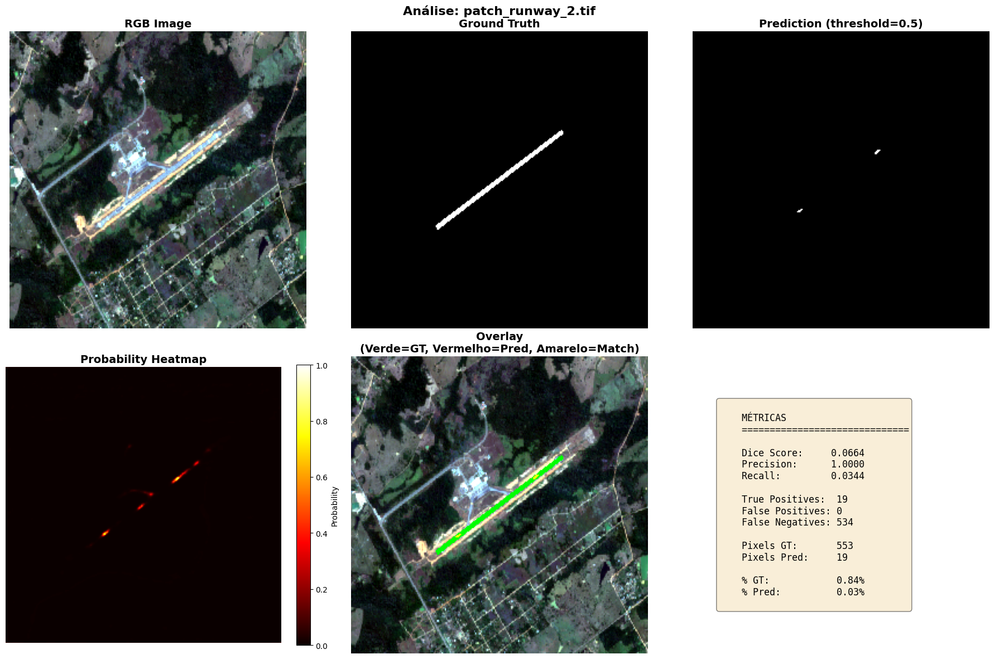

/content/drive/MyDrive/S2_dataset/test/patch_runway_6.tif


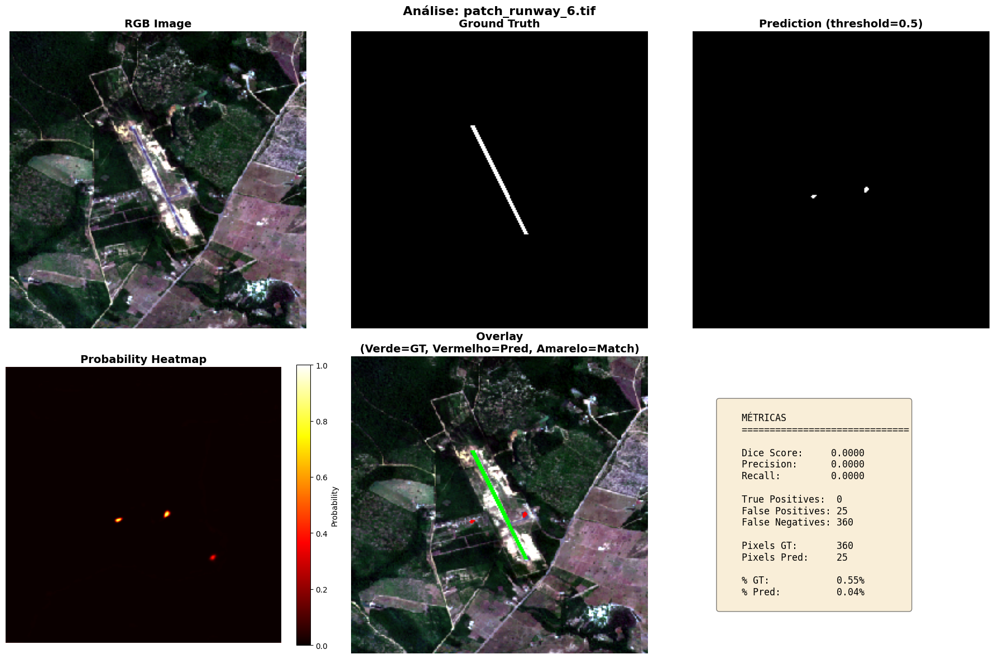

/content/drive/MyDrive/S2_dataset/test/patch_runway_8.tif


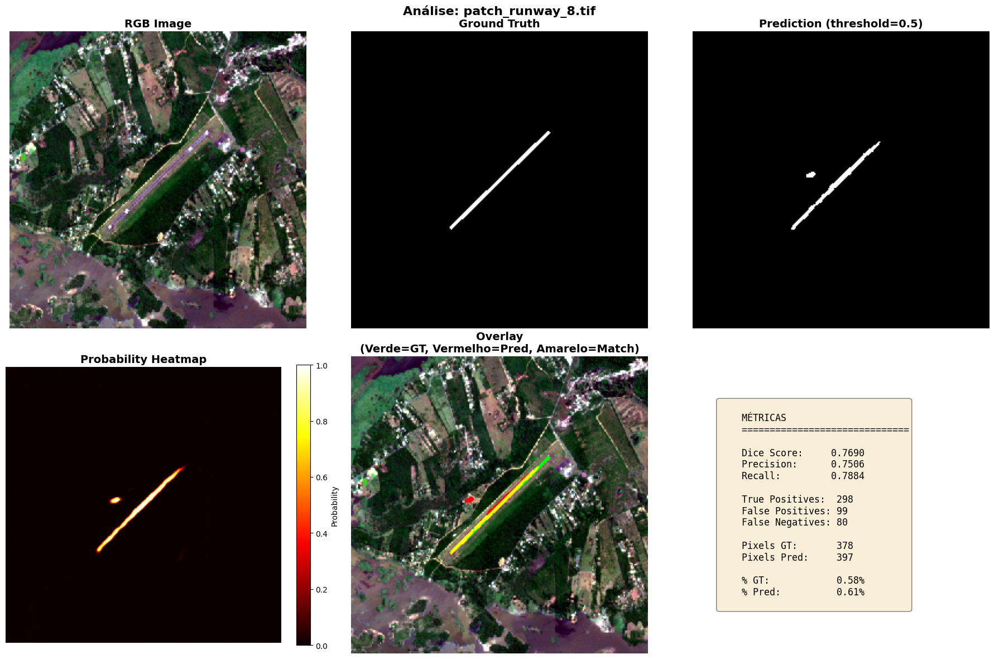

/content/drive/MyDrive/S2_dataset/test/patch_runway_30.tif


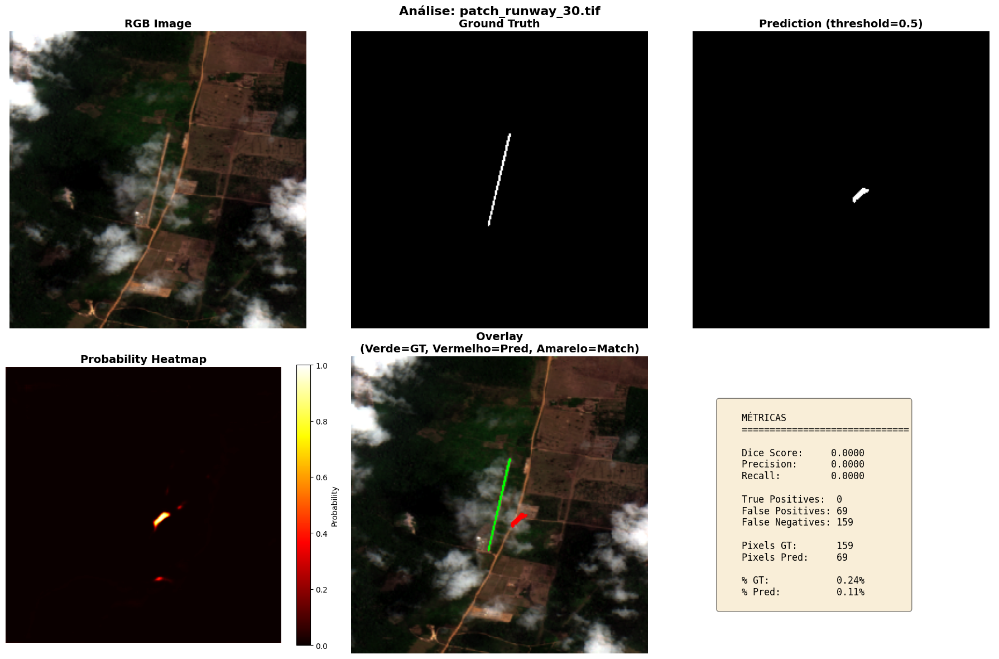

/content/drive/MyDrive/S2_dataset/test/patch_runway_31.tif


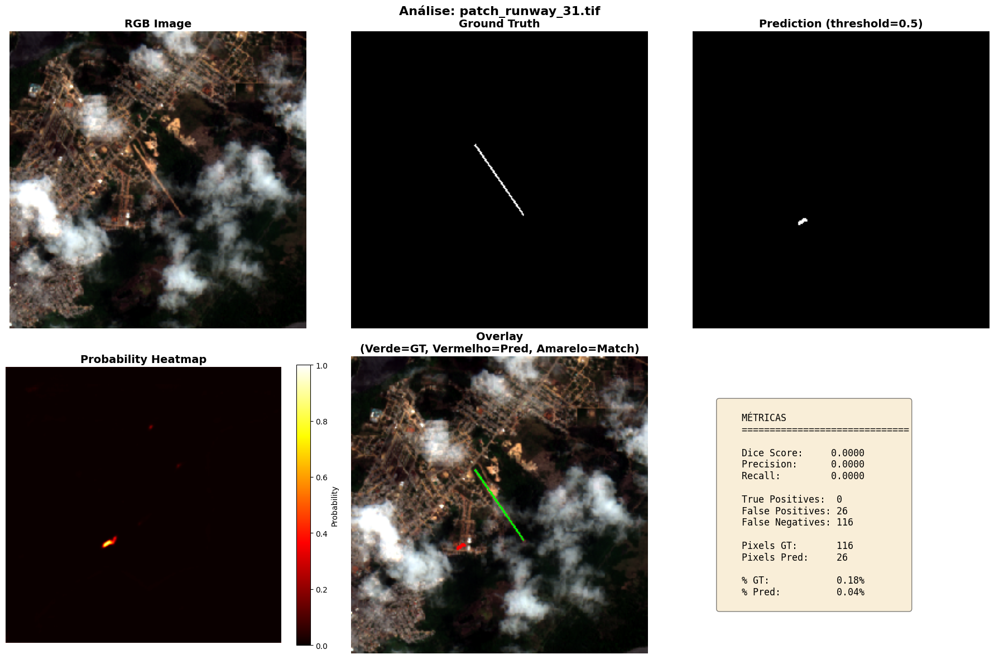

/content/drive/MyDrive/S2_dataset/test/patch_runway_41.tif


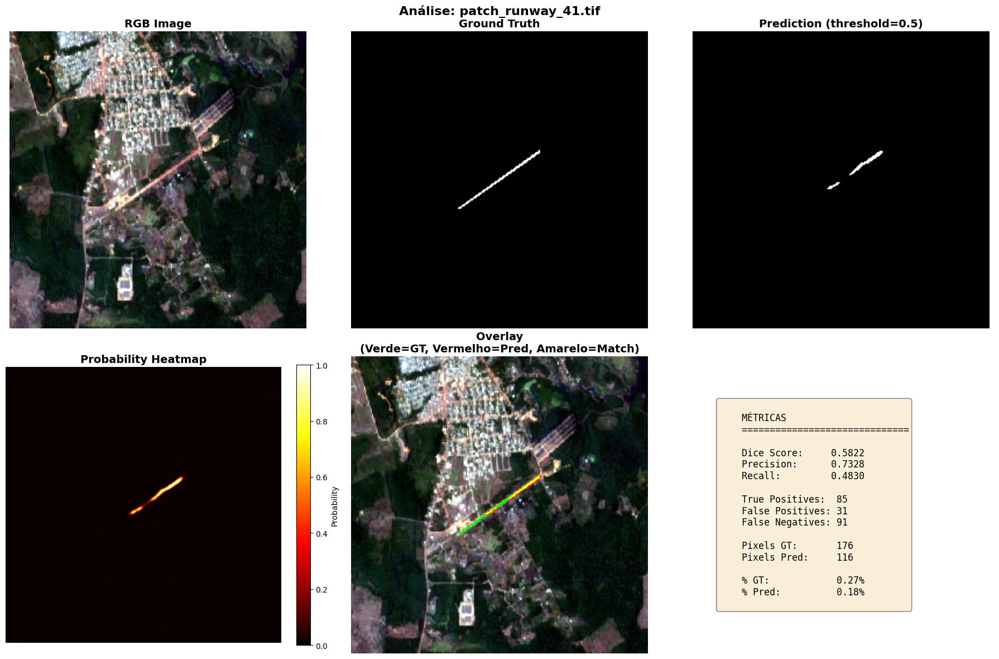

/content/drive/MyDrive/S2_dataset/test/patch_runway_43.tif


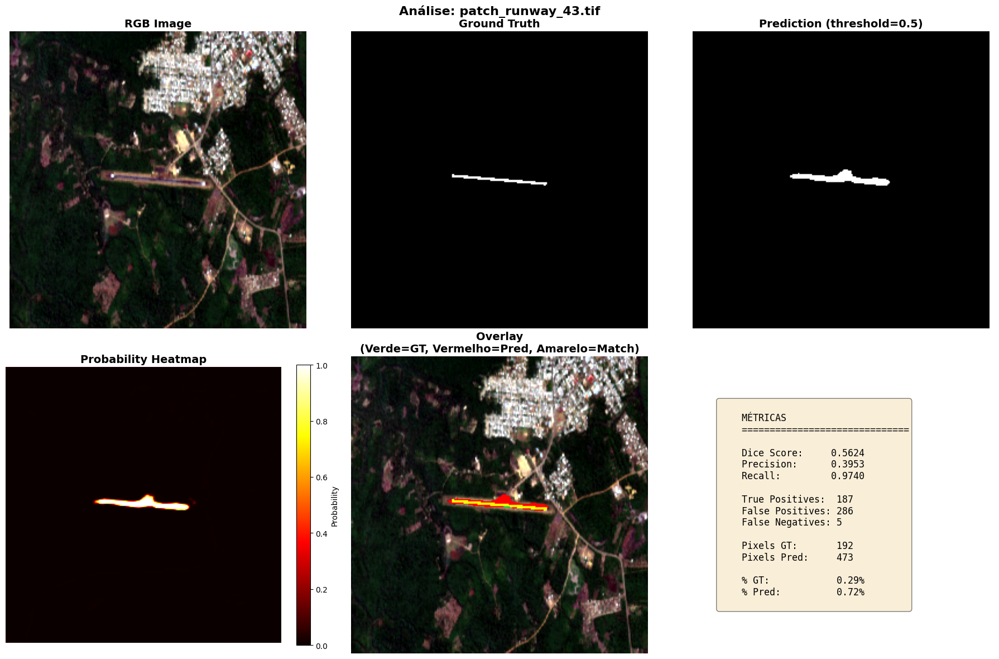

/content/drive/MyDrive/S2_dataset/test/patch_runway_47.tif


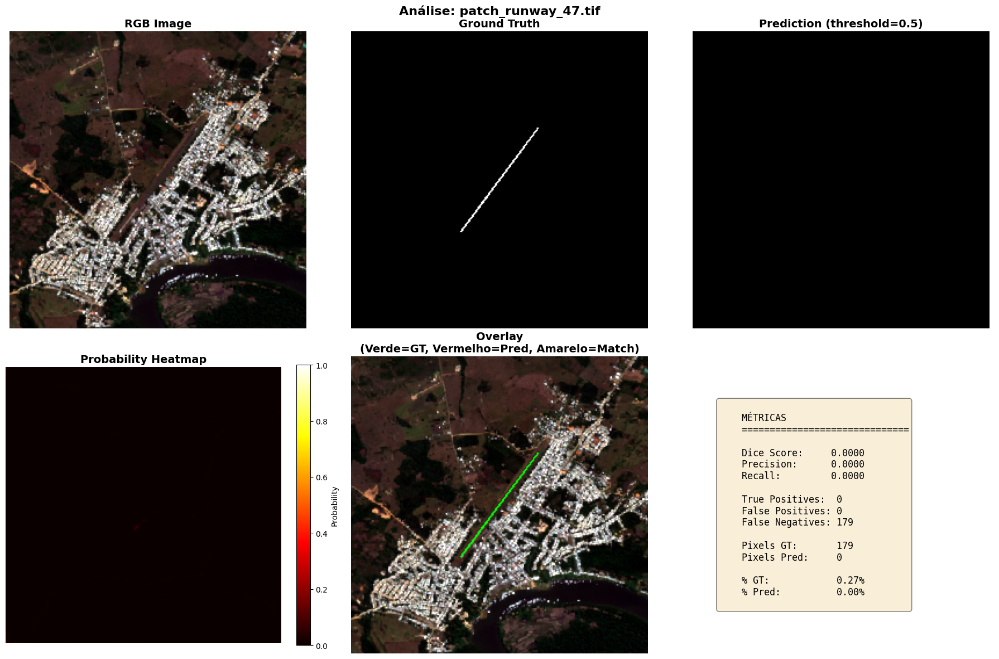

/content/drive/MyDrive/S2_dataset/test/patch_negative_0.tif


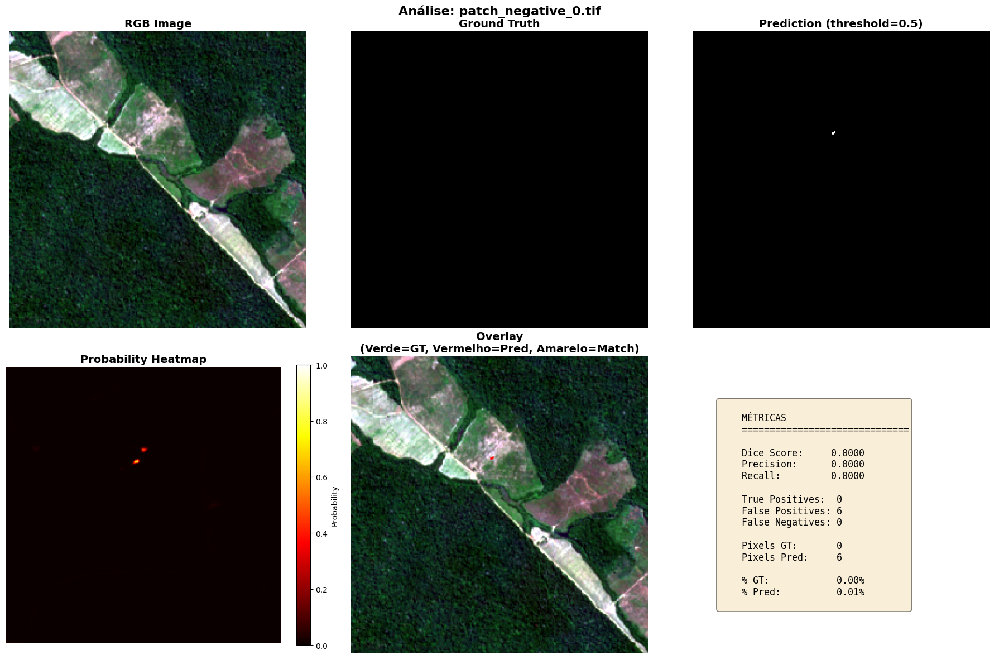

/content/drive/MyDrive/S2_dataset/test/patch_negative_3.tif


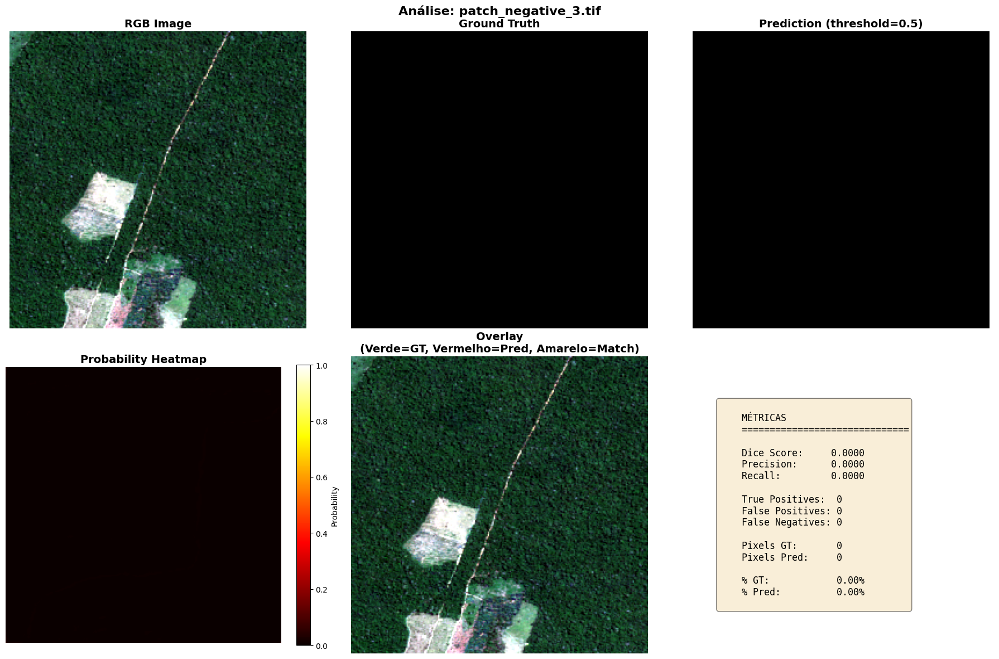

/content/drive/MyDrive/S2_dataset/test/patch_negative_8.tif


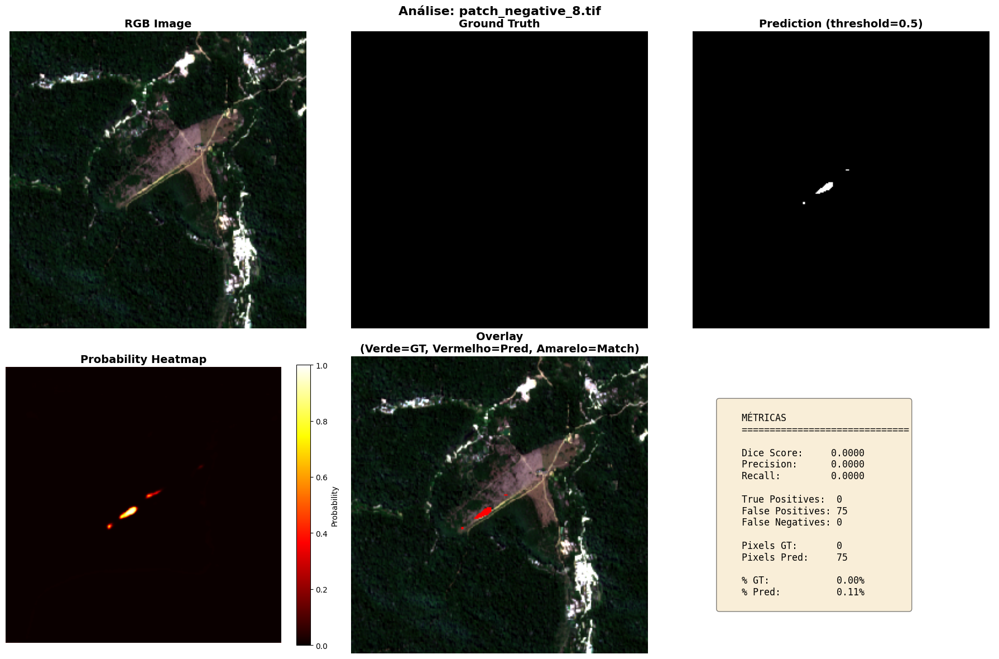

/content/drive/MyDrive/S2_dataset/test/patch_negative_11.tif


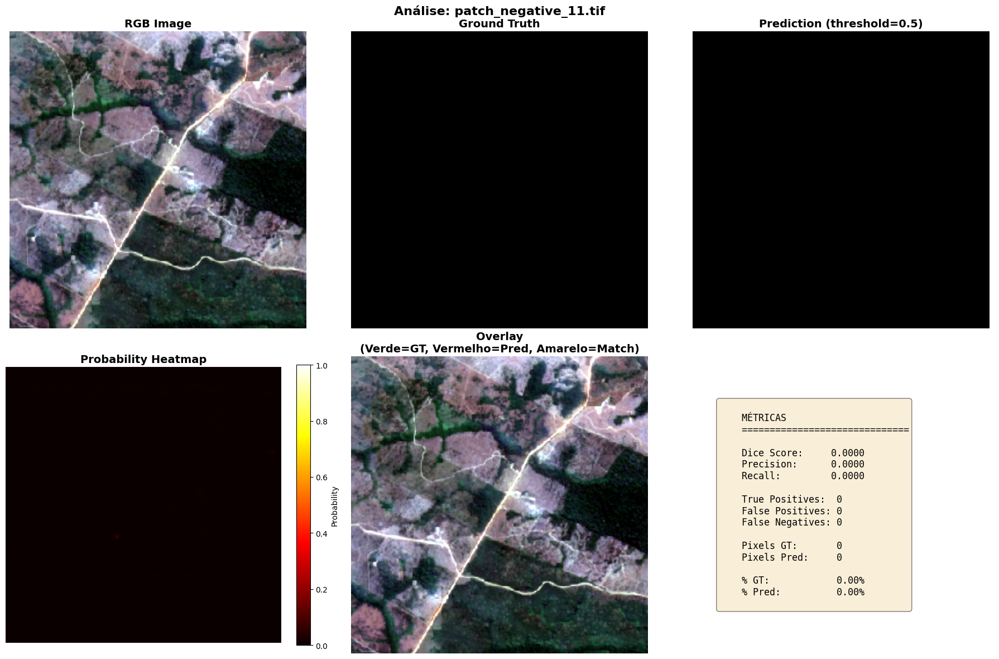

/content/drive/MyDrive/S2_dataset/test/patch_negative_24.tif


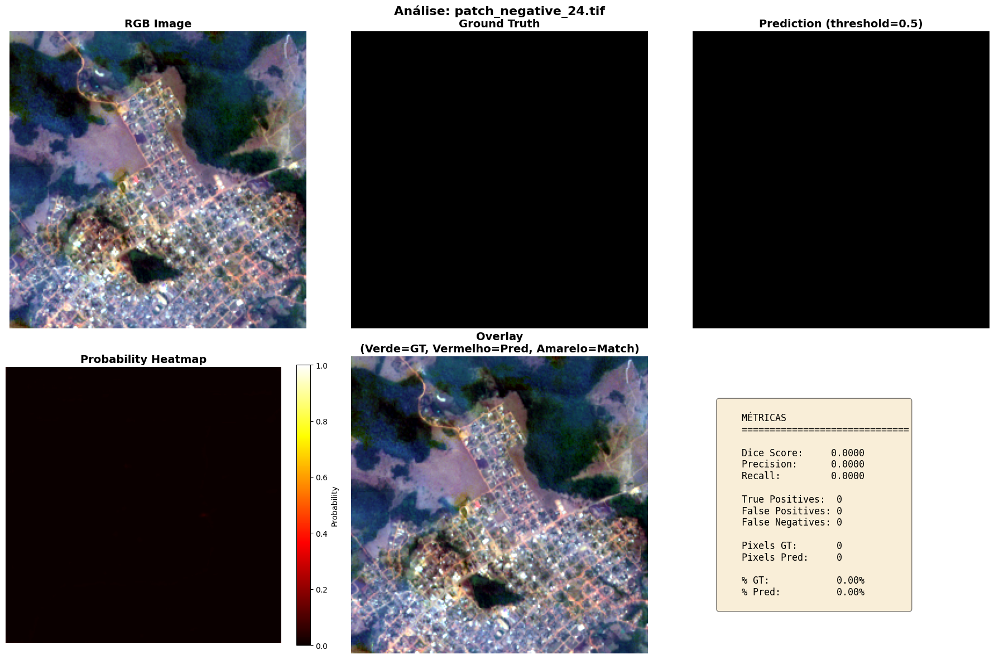

/content/drive/MyDrive/S2_dataset/test/patch_negative_29.tif


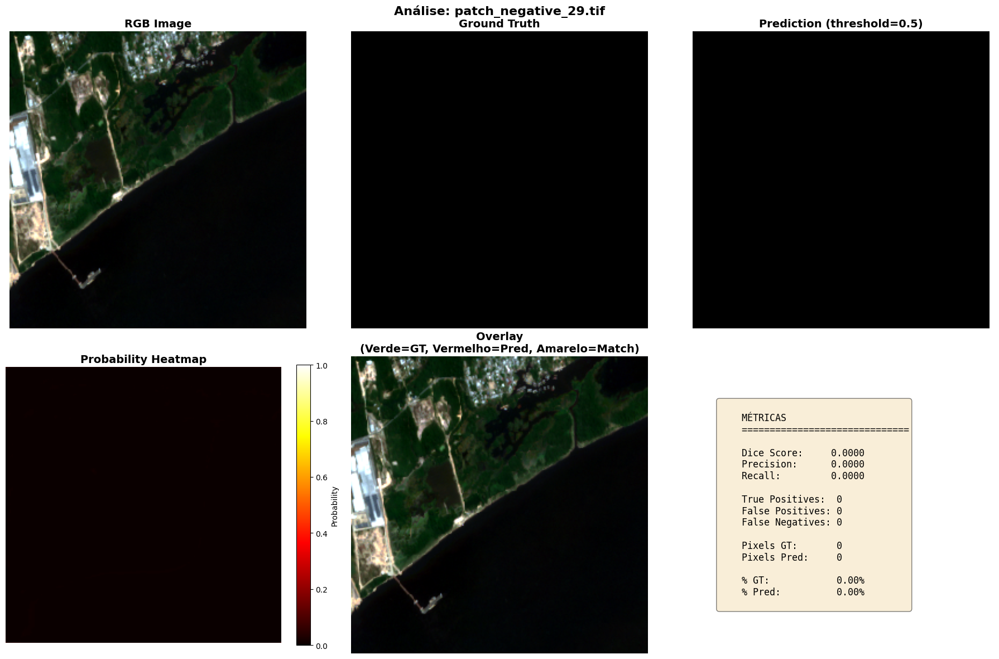

/content/drive/MyDrive/S2_dataset/test/patch_negative_33.tif


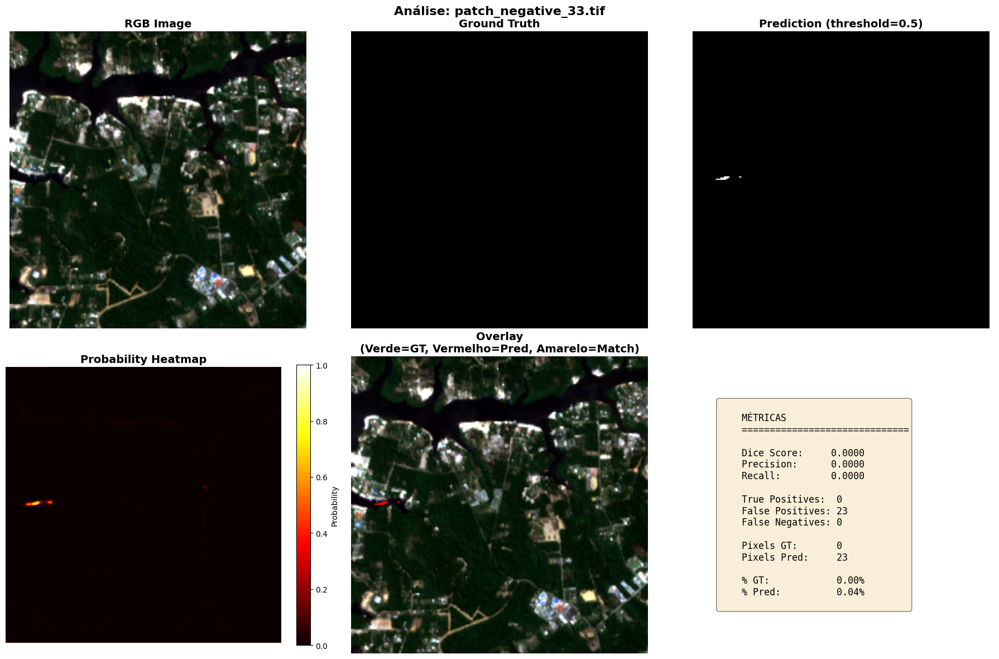

/content/drive/MyDrive/S2_dataset/test/patch_negative_34.tif


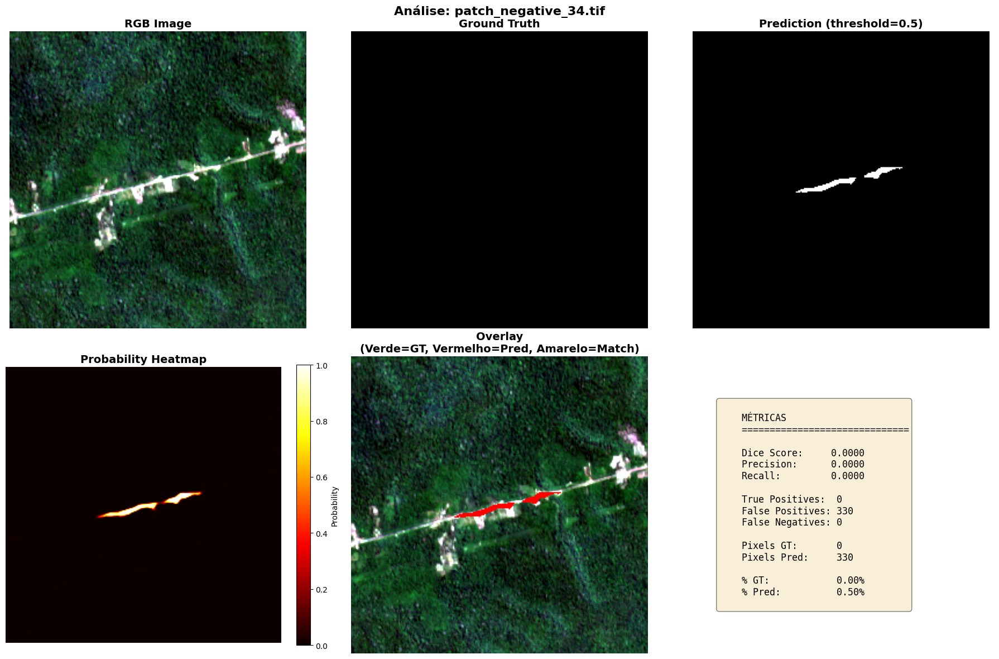

/content/drive/MyDrive/S2_dataset/test/patch_negative_39.tif


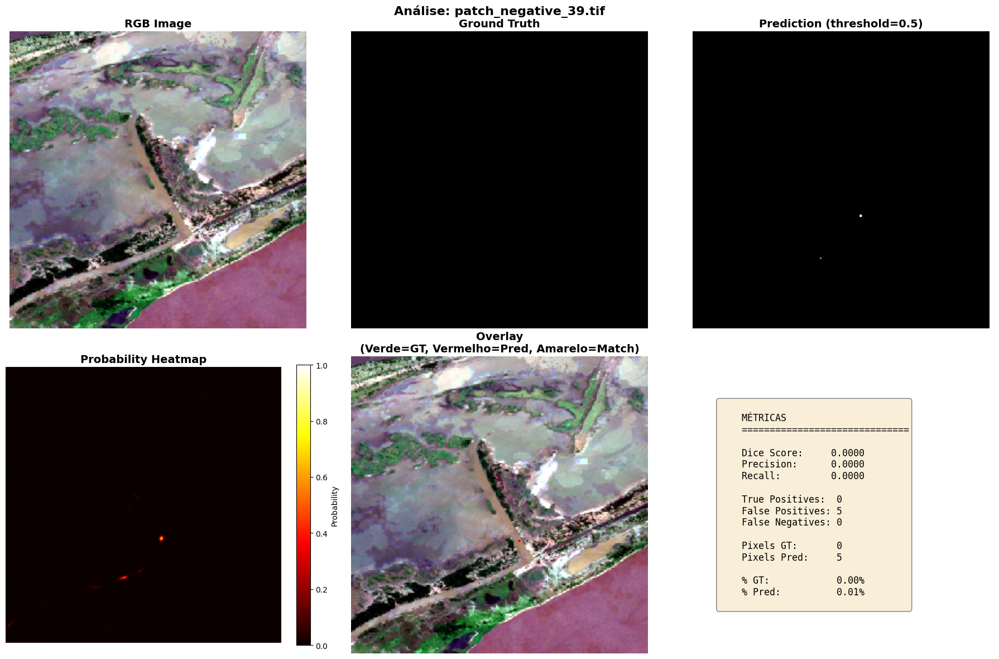

/content/drive/MyDrive/S2_dataset/test/patch_negative_43.tif


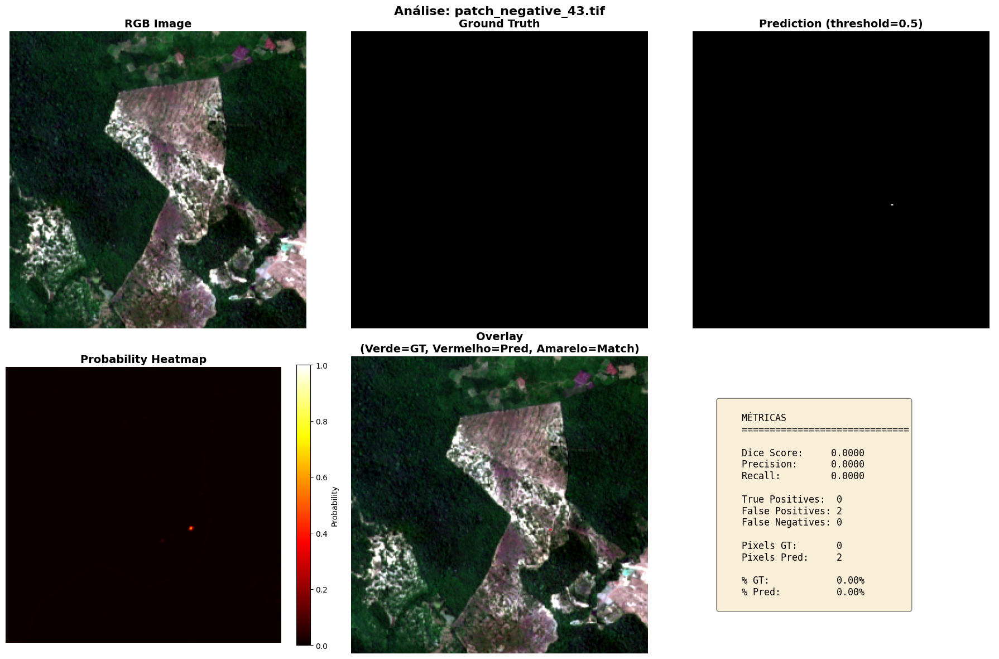

/content/drive/MyDrive/S2_dataset/test/patch_negative_45.tif


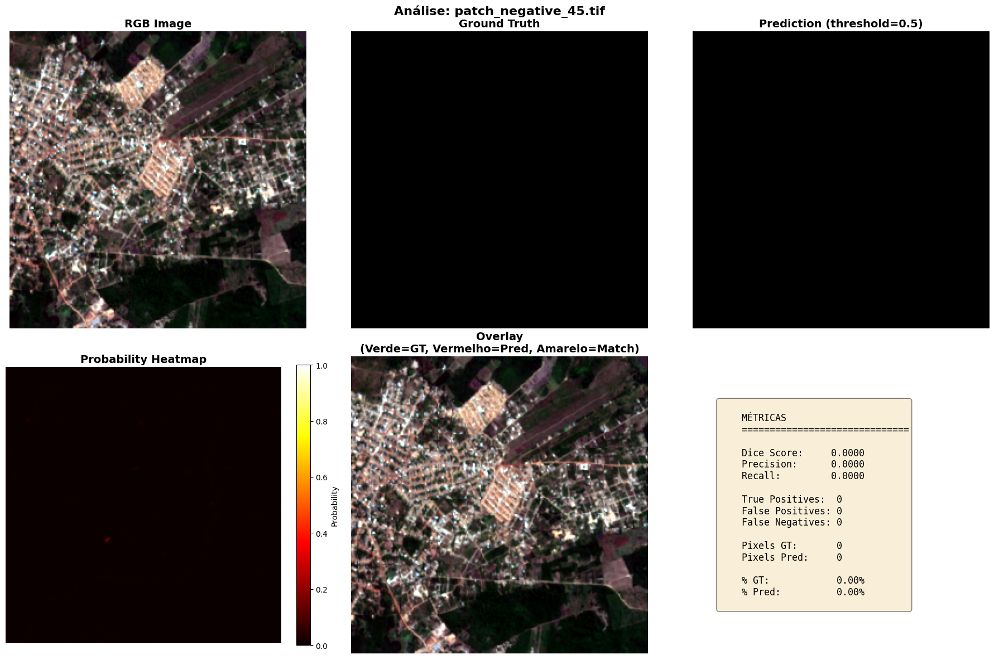

/content/drive/MyDrive/S2_dataset/test/patch_negative_66.tif


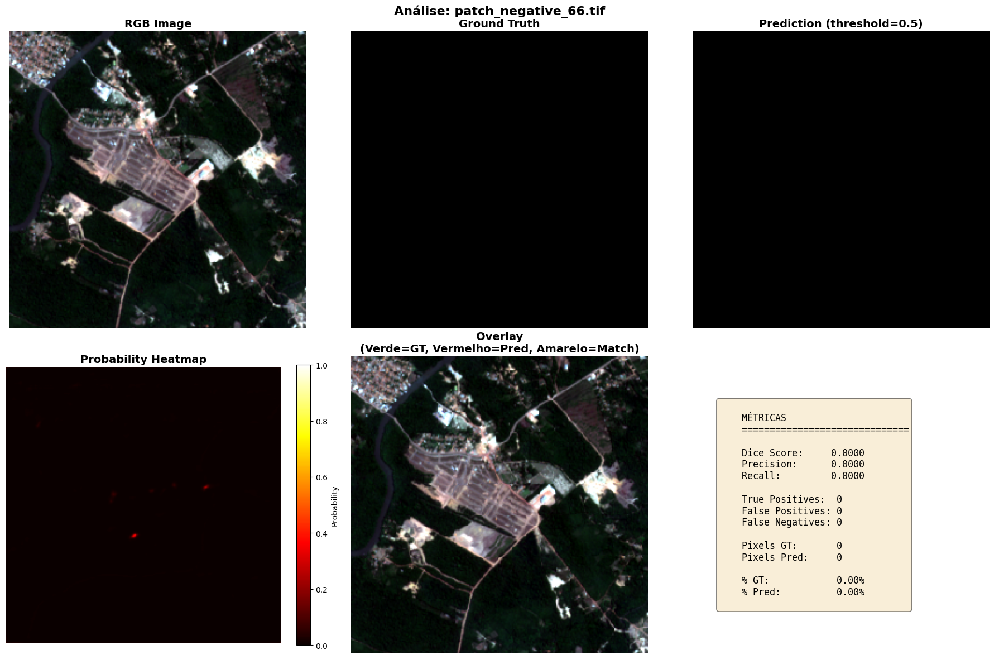

/content/drive/MyDrive/S2_dataset/test/patch_negative_75.tif


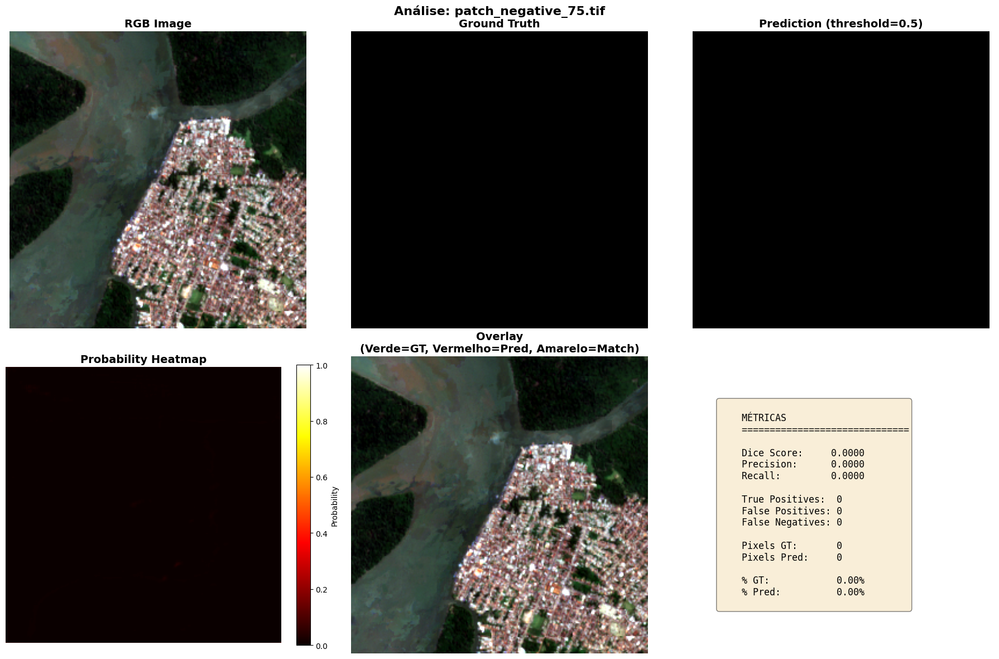

/content/drive/MyDrive/S2_dataset/test/patch_negative_81.tif


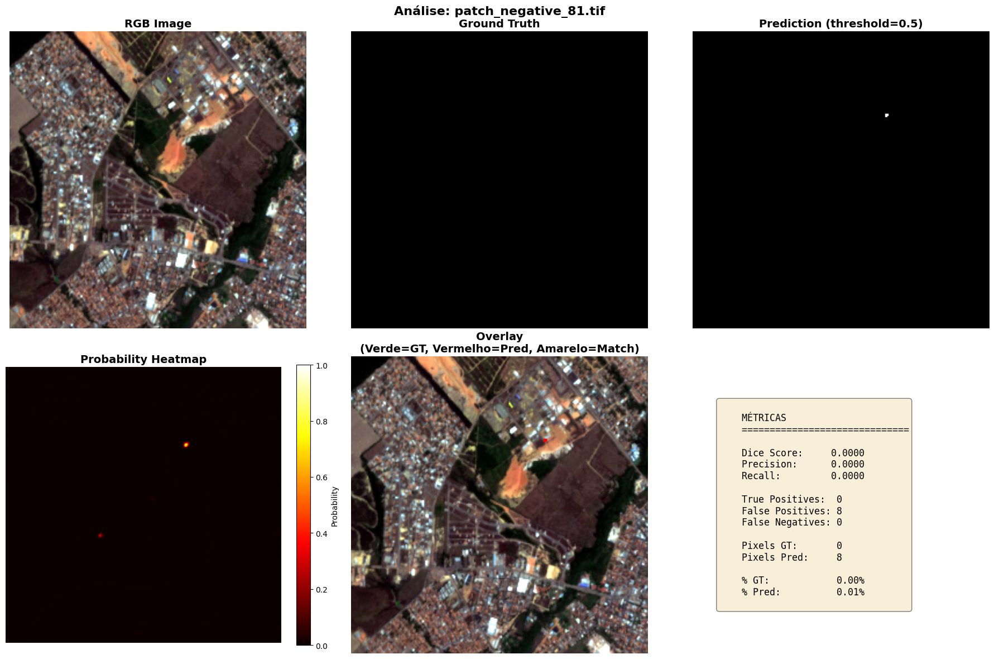

/content/drive/MyDrive/S2_dataset/test/patch_negative_84.tif


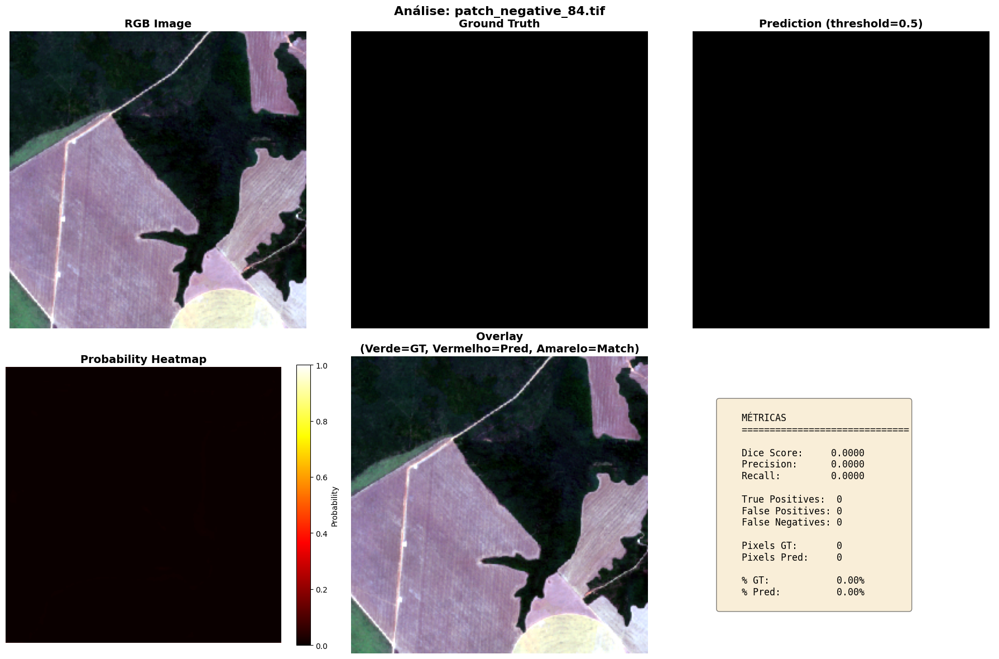

/content/drive/MyDrive/S2_dataset/test/patch_negative_97.tif


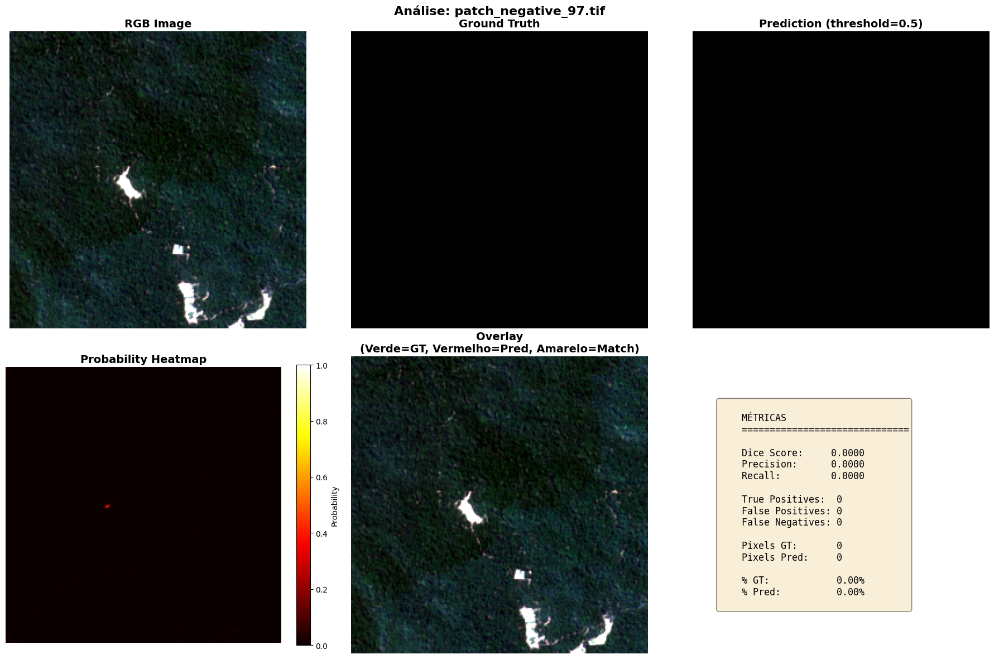

In [59]:
# USO PARA DEBUG E TESTE
# APLICA O MODELO NOS TESTES DO DATASET

test_images = glob.glob(os.path.join(DATA_DIR, 'test', '*.tif'))

for patch in test_images:
  print()
  show_results(patch, model)
  print()



#APLICAÇÃO NO SUDOESTE DO PARÁ

In [28]:
# Definir região do sudoeste do Pará (aproximado)

sudoeste = ee.Geometry.Polygon(
        [[[-52.59613841351879, -6.356783660086396],
          [-49.53139991911596, -4.1783899397969275],
          [-50.80598796677149, -3.2356036897198157],
          [-51.981646456329756, -2.3468091876791863],
          [-52.82415797738518, -2.666002061317475],
          [-55.15338003304118, -4.179507232248292],
          [-56.88401724358476, -3.4980446511415733],
          [-58.264167624420864, -6.472092530381011],
          [-58.39189266335144, -6.489137552713428],
          [-58.48312523993456, -6.66157339391492],
          [-58.50848282647474, -6.850370490054427],
          [-58.32116101917348, -7.0813813664840985],
          [-58.18305487714016, -7.421333170394046],
          [-58.013928854262865, -7.548258831740347],
          [-57.86107006324287, -7.980021884800475],
          [-57.60403620768598, -8.76695341287983],
          [-57.486903027374126, -8.785864823966355],
          [-57.43291865830161, -8.864470269651912],
          [-57.220427871552616, -8.965931706383422],
          [-57.09348147150538, -9.079017585255384],
          [-57.05920840339714, -9.220539857425926],
          [-56.89857928220598, -9.321853555562422],
          [-56.76454136759605, -9.423836790332489],
          [-56.660698026938014, -9.374030990177522],
          [-56.31023861879713, -9.397560736591272],
          [-55.68342537336057, -9.452003914837505],
          [-54.5228504531194, -9.544480614217953],
          [-52.20570739868281, -9.709751455971016]]]);


In [24]:
"""
Este código aplica o modelo treinado em uma região grande do GEE,
dividindo em tiles, fazendo predições e montando um mosaico.
"""

import torch
import numpy as np
import rasterio
from rasterio.transform import from_bounds
import segmentation_models_pytorch as smp
from scipy.ndimage import binary_opening, binary_closing
import matplotlib.pyplot as plt
from tqdm import tqdm
import requests
from io import BytesIO



def mask_s2_clouds(image):

  # Mascara nuvens do Sentinel-2

  qa = image.select('QA60')
  cloud_bit_mask = 1 << 10
  cirrus_bit_mask = 1 << 11
  mask = qa.bitwiseAnd(cloud_bit_mask).eq(0).And(qa.bitwiseAnd(cirrus_bit_mask).eq(0))
  return image.updateMask(mask).divide(10000)


def get_s2_composite(region, start_date='2024-07-01', end_date='2024-09-30', max_cloud=20):

  # Cria composite Sentinel-2 com 8 bandas (B4,B3,B2,B8,B11,B12,NDVI,NDBI)

  # Dataset Sentinel-2
  dataset = ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED') \
      .filterDate(start_date, end_date) \
      .filterBounds(region) \
      .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', max_cloud)) \
      .map(mask_s2_clouds)

  # Verificar se ha imagens
  if dataset.size().getInfo() == 0:
      print(' Nenhuma imagem encontrada para esta região/período')
      return None

  # Composite mediano
  # Unmask preenche preenche vazios com zero impedindo erro no calculo do ndvi e ndbi
  composite = dataset.median().unmask(0)

  # Índices
  ndvi = composite.normalizedDifference(['B8', 'B4']).rename('NDVI')
  ndbi = composite.normalizedDifference(['B11', 'B8']).rename('NDBI')

  # Imagem final (8 bandas)
  final_image = composite.select(['B4', 'B3', 'B2', 'B8', 'B11', 'B12']).addBands(ndvi).addBands(ndbi)

  return final_image.clip(region)


def create_grid(region, tile_size_meters=2560):

  # Divide a regiao em grids de tiles

  # Pegar bounds da regiao
  bounds = region.bounds().getInfo()['coordinates'][0]

  min_lon = min([p[0] for p in bounds])
  max_lon = max([p[0] for p in bounds])
  min_lat = min([p[1] for p in bounds])
  max_lat = max([p[1] for p in bounds])

  # Converter metros para graus (aproximacao)
  # 1 grau ~111km no equador
  tile_size_deg = tile_size_meters / 111000

  # Criar grid
  tiles = []
  lat = min_lat

  while lat < max_lat:
      lon = min_lon
      while lon < max_lon:
          tile = ee.Geometry.Rectangle([lon, lat, lon + tile_size_deg, lat + tile_size_deg])

          # Verificar se tile intersecta com regiao
          if tile.intersects(region).getInfo():
              tiles.append(tile)

          lon += tile_size_deg
      lat += tile_size_deg

  return tiles

def download_tile(image, tile_geom, scale=10):

  try:

    # Pegar os bounds exatos do tile
    bbox = tile_geom.bounds().getInfo()['coordinates'][0]

    lons = [p[0] for p in bbox]
    lats = [p[1] for p in bbox]
    region_coords = [min(lons), min(lats), max(lons), max(lats)]

    # Obter URL
    url = image.getDownloadURL({
        'region': tile_geom,  # A geometria do tile
        'format': 'NPY',
        'dimensions': '256x256' # Forcca o shape que o modelo precisa
    })

    response = requests.get(url, timeout=60)

    if response.status_code != 200:
        print(f'Erro no GEE: {response.text}')
        return None

    # Carregar dados
    data = np.load(BytesIO(response.content), allow_pickle=True)

    # Converter para um array numerico puro (C, H, W)
    if data.dtype.names:

        # Empilha as bandas na ordem correta
        data = np.array([data[name] for name in data.dtype.names], dtype=np.float32)

    return data

  except Exception as e:
    print(f'Erro no download: {e}')
    return None

In [13]:
def normalize_tile(tile_data):

  #Normaliza tile da mesma forma que no treino (numpy array (8, 256, 256))

  normalized = []

  for band in tile_data:

      # Normalização por percentis (igual ao treino)
      p1 = np.percentile(band, 1)
      p99 = np.percentile(band, 99)
      band_norm = (band - p1) / (p99 - p1 + 1e-8)
      band_norm = np.clip(band_norm, 0, 1)
      normalized.append(band_norm)

  normalized = np.stack(normalized)

  # Converter para tensor
  tensor = torch.FloatTensor(normalized).unsqueeze(0)  # (1, 8, 256, 256)

  return tensor

#Remove ruido da predicao
def clean_predict(pred_mask):

  clean_pred = binary_opening(pred_mask, structure=np.ones((3, 3)))
  clean_pred = binary_closing(clean_pred, structure=np.ones((5, 5)))
  return clean_pred.astype(np.uint8)

def predict_tile(model, tile_data, device='cuda', threshold=0.6, clean=True):

  #Faz predicao em um tile

  # Normalizar
  tile_tensor = normalize_tile(tile_data).to(device)

  # Predicao
  with torch.no_grad():
      prediction = model(tile_tensor)
      prob_map = torch.sigmoid(prediction).squeeze().cpu().numpy()

  # Binarizar
  pred_mask = (prob_map > threshold).astype(np.uint8)

  # Limpar se solicitado
  if clean:
      pred_mask = clean_predict(pred_mask)

  return pred_mask

In [26]:
def detect_runways_in_region(model, region, device='cuda',
                             start_date='2024-07-01', end_date='2024-09-30',
                             threshold=0.6, visualize=True):
  # Loop principal

  print()
  print(' Iniciando...')
  print()

  # Criar composite
  print('\n Criando composite Sentinel-2...')
  composite = get_s2_composite(region, start_date, end_date)

  if composite is None:
      return None

  print(' Composite criado')

  # 2. Dividir em tiles
  print('\n Dividindo região em tiles...')
  tiles = create_grid(region, tile_size_meters=2560)
  print(f' {len(tiles)} tiles criados')

  # 3. Processar cada tile
  print('\n Processando tiles...')

  results = {
      'tiles_processed': 0,
      'tiles_with_detections': 0,
      'total_runway_pixels': 0,
      'detections': []
  }

  model.eval()

  for i, tile_geom in enumerate(tqdm(tiles, desc="Processando")):

      # Baixar tile
      tile_data = download_tile(composite, tile_geom)

      if tile_data is not None:

          # 1. Preparar o RGB (Bandas B4, B3, B2 estão nos índices 0, 1, 2)
          rgb = np.transpose(tile_data[:3], (1, 2, 0))

          # Normalizacao simples para ver as arvores (stretch de 2% a 98%)
          p2, p98 = np.percentile(rgb, (2, 98))
          rgb_viz = np.clip((rgb - p2) / (p98 - p2 + 1e-6), 0, 1)

          # 2. Preparar as bandas SWIR e indices
          swir1 = tile_data[4] # B11
          ndvi = tile_data[6]  # NDVI

          # 3. Criar o Plot de Diagnostico
          plt.figure(figsize=(15, 5))

          plt.subplot(1, 3, 1)
          plt.imshow(rgb_viz)
          plt.title(f'Tile {i} - Visão Real (RGB)')
          plt.axis('off')

          plt.subplot(1, 3, 2)
          plt.imshow(swir1, cmap='magma')
          plt.title('Banda SWIR (B11)')
          plt.axis('off')

          plt.subplot(1, 3, 3)
          plt.imshow(ndvi, cmap='Spectral')
          plt.title('NDVI - Vegetação')
          plt.axis('off')

          plt.show()

      if tile_data is None:
          print('NO DATA')
          continue

      # Fazer predicao
      pred_mask = predict_tile(model, tile_data, device, threshold, clean=True)

      # Verificar se detectou algo
      num_runway_pixels = pred_mask.sum()

      if num_runway_pixels > 50:  # Mínimo de 50 pixels para considerar deteccão
          results['tiles_with_detections'] += 1
          results['total_runway_pixels'] += num_runway_pixels

          # Guardar deteccao
          results['detections'].append({
              'tile_index': i,
              'tile_geom': tile_geom,
              'num_pixels': int(num_runway_pixels),
              'pred_mask': pred_mask
          })

      results['tiles_processed'] += 1

  # 4. Resumo
  print()
  print(' RESUMO DOS RESULTADOS')
  print()
  print(f' Tiles processados: {results['tiles_processed']}')
  print(f' Tiles com detecções: {results['tiles_with_detections']}')
  print(f' Total de pixels de pista: {results['total_runway_pixels']}')
  print(f' Área estimada de pistas: {results['total_runway_pixels'] * 100 / 10000:.2f} hectares')
  print()

  # 5. Visualizar se solicitado
  if visualize and results['tiles_with_detections'] > 0:
      visualize_detections(results, composite, region)

  return results

In [15]:
def visualize_detections(results, composite, region):

    #Visualiza deteccoes encontradas

    num_detections = min(5, results['tiles_with_detections'])

    if num_detections == 0:
        print(' Nenhuma detecção para visualizar')
        return

    fig, axes = plt.subplots(num_detections, 2, figsize=(12, 5*num_detections))

    if num_detections == 1:
        axes = axes.reshape(1, -1)

    print(f"\n Visualizando {num_detections} detecções...")

    for i, detection in enumerate(results['detections'][:num_detections]):
        tile_geom = detection['tile_geom']
        pred_mask = detection['pred_mask']

        # Baixar tile RGB para visualização
        rgb_bands = composite.select(['B4', 'B3', 'B2'])
        tile_rgb = download_tile(rgb_bands, tile_geom)

        if tile_rgb is not None:
            # Normalizar RGB
            rgb = np.transpose(tile_rgb[:3], (1, 2, 0))
            rgb = np.clip(rgb / np.percentile(rgb, 99), 0, 1)

            # RGB
            axes[i, 0].imshow(rgb)
            axes[i, 0].set_title(f'Detecção {i+1} - RGB')
            axes[i, 0].axis('off')

            # Overlay
            overlay = rgb.copy()
            overlay[pred_mask > 0] = [1, 0, 0]  # Vermelho para pista

            axes[i, 1].imshow(overlay)
            axes[i, 1].set_title(f'Detecção {i+1} - Pistas em vermelho\n({detection["num_pixels"]} pixels)')
            axes[i, 1].axis('off')

    plt.tight_layout()
    plt.savefig('deteccoes_regiao.png', dpi=150)
    plt.show()

    print("Visualizacoes salvas em 'deteccoes_regiao.png'")

Carregando modelo...
✓ Modelo carregado em cpu

Região de interesse definida
Tamanho aproximado: ~20km x 20km
PIPELINE DE DETECÇÃO DE PISTAS

1. Criando composite Sentinel-2...
✓ Composite criado

2. Dividindo região em tiles...
✓ 2 tiles criados

3. Processando tiles...


Processando:   0%|          | 0/2 [00:00<?, ?it/s]

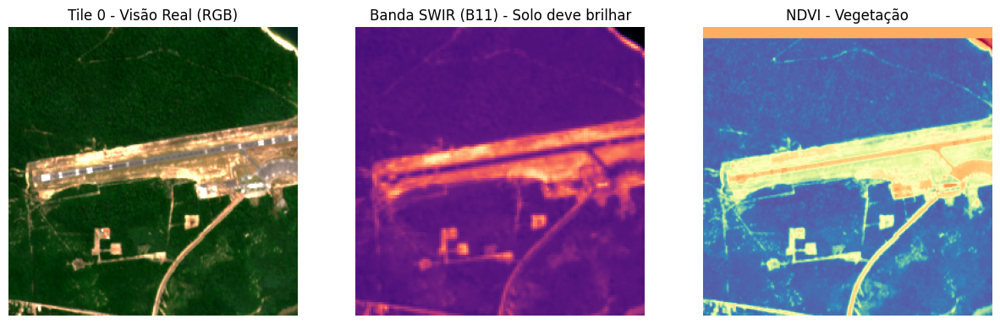

Processando:  50%|█████     | 1/2 [00:02<00:02,  2.57s/it]

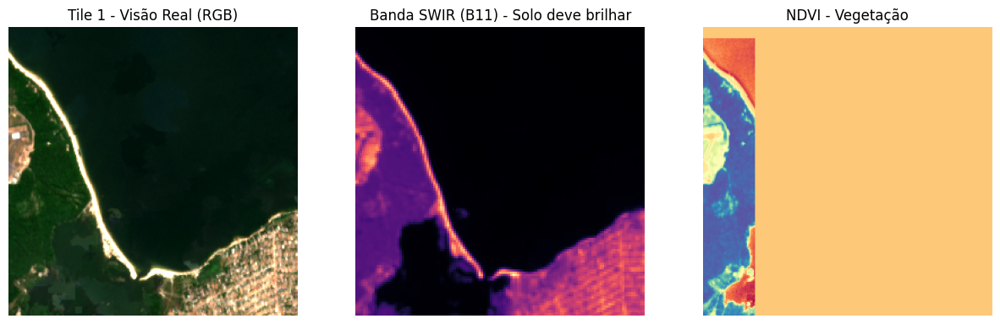

Processando: 100%|██████████| 2/2 [00:05<00:00,  2.54s/it]



RESUMO DOS RESULTADOS
Tiles processados: 2
Tiles com detecções: 1
Total de pixels de pista: 743
Área estimada de pistas: 7.43 hectares

Visualizando 1 detecções...


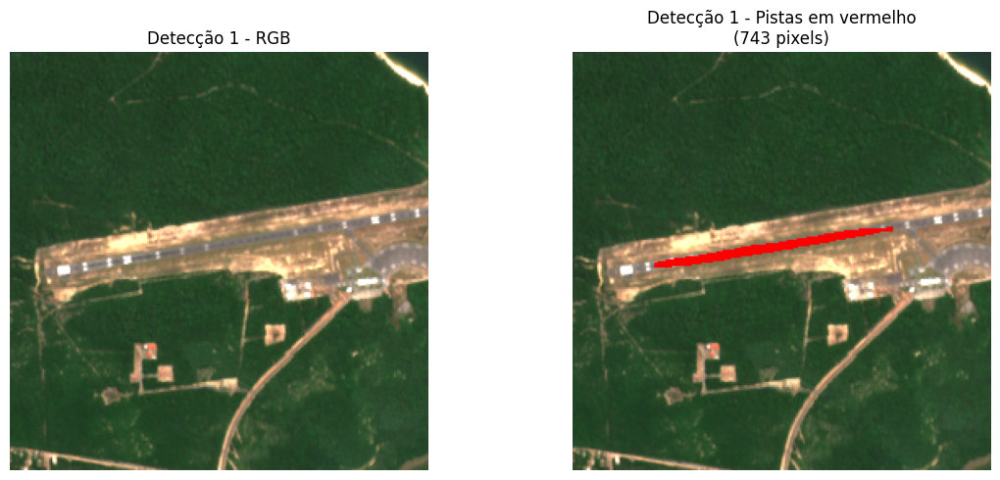

✓ Visualizações salvas em 'deteccoes_regiao.png'

✓ Detecções encontradas!
  Use os resultados para análise posterior

Coordenadas das detecções:
  Detecção 1: Lon=-54.7946, Lat=-2.4236


In [27]:
if __name__ == "__main__":

  # Carregar modelo treinado
  print(" Carregando modelo...")
  device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

  model = smp.Unet(
      encoder_name='mit_b2',
      encoder_weights=None,
      in_channels=8,
      classes=1
  )


  # ATENCAO:
  # SE VOCE PULOU O TREINO PARA USAR O MODELO JA TREINADO
  # DEFINA O DIRETORIO AQUI
  #
  # DATA_DIR + 'modelo.pth
  model.load_state_dict(torch.load('modelo.pth', map_location=device))
  #

  model = model.to(device)
  model.eval()

  print(f'Modelo carregado em {device}')

  # Regiao
  region = sudoeste

  print(f'\n Região de interesse definida')

  # Executar pipeline
  results = detect_runways_in_region(
      model=model,
      region=region,
      device=device,
      start_date='2024-07-01',
      end_date='2024-09-30',
      threshold=0.6,  # Mude o threshold se preferir
      visualize=True
  )

  # Salvar resultados
  if results and results['tiles_with_detections'] > 0:
      print('\n Pista encontrada')

      # Exportar coordenadas
      print("\n Coordenadas:")
      for i, det in enumerate(results['detections']):
          coords = det['tile_geom'].centroid().getInfo()['coordinates']
          print(f" Pista {i+1}: Lon={coords[0]:.4f}, Lat={coords[1]:.4f}")
  else:
      print('\n Nenhuma pista detectada na região')
      print()

#Referências


- Xie, E., Wang, W., Yu, Z., Anandkumar, A., Alvarez, J. M., & Luo, P. (2021). SegFormer: Simple and efficient design for semantic segmentation with transformers. arXiv preprint arXiv:2105.15203. https://arxiv.org/abs/2105.15203

- Google Earth Engine Data Catalog. (n.d.). Harmonized Sentinel-2 MSI: MultiSpectral Instrument, Level-2A (SR). European Union/ESA/Copernicus.
https://developers.google.com/earth-engine/datasets/catalog/COPERNICUS_S2_SR_HARMONIZED

- Iakubovskii, P. (2019). Segmentation Models PyTorch. GitHub repository. https://github.com/qubvel/segmentation_models.pytorch

- Sahilcarterr. (2023, dezembro 26). Why nn.BCEWithLogitsLoss Numerically Stable. Medium. https://medium.com/@sahilcarterr/why-nn-bcewithlogitsloss-numerically-stable-6a04f3052967

- Pistas de Pouso. (s.d.). Earth Engine App. Google Earth Engine. Recuperado em 27 de dezembro de 2025, de https://solvedgeo.users.earthengine.app/view/pistas-de-pouso.

- “Projeto MapBiomas - Mapa de Pistas de Pouso da Amazonia 2021 (v1)”
acessado em 29 de dezembro de 2025 através do link: https://brasil.mapbiomas.org/wp-content/uploads/sites/4/2023/08/MapBiomas_Pistas_de_Pouso_06.02.2023_1.pdf”

- PyTorch. (2025). torch. Documentação oficial do PyTorch. Recuperado em 29 dezembro de 2025, de
https://docs.pytorch.org/docs/stable/torch.html

- Google Earth Engine. (2025). Exporting images. Google Developers Guide. Disponível em:
https://developers.google.com/earth-engine/guides/exporting_images
​
- Instituto Nacional de Pesquisas Espaciais - INPE. (2019). Aplicação de Índices de Vegetação ara Identificação de Área
Construída e Vegetação Densa em Áreas Urbanas na Amazônia. Repositório Marte2. Disponível em: http://marte2.sid.inpe.br/col/sid.inpe.br/marte2/2019/10.31.12.02/doc/97992.pdf


#Códigos auxiliares

## Coordenadas das pistas usadas para montar o dataset de treino

```
var pistas_v1 = /* color: #0dff00 */ee.FeatureCollection(
        [ee.Feature(
            ee.Geometry.Polygon(
                [[[-60.06238693505175, -3.038831802356072],
                  [-60.03694430912512, -3.038841930841691],
                  [-60.036962438191864, -3.038227761185016],
                  [-60.06238413287388, -3.038292758157589]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "0"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-72.78102487664952, -7.599730485982458],
                  [-72.75813660566601, -7.600915259122987],
                  [-72.75812319462094, -7.600306429767069],
                  [-72.78100186252064, -7.599109214436939]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "1"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-67.90254810278425, -9.874897944219216],
                  [-67.88501665363653, -9.863623687694378],
                  [-67.8853546119724, -9.863185022216564],
                  [-67.90289372962516, -9.87439791679872]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "2"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-68.78455037140307, -11.049893351561668],
                  [-68.78000450245096, -11.02569137933174],
                  [-68.78061604610636, -11.025680848533423],
                  [-68.78512635904426, -11.04994600150794]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "3"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-68.48790180890936, -10.659579750419702],
                  [-68.48428005707872, -10.66768569757577],
                  [-68.48396623862398, -10.667543361461696],
                  [-68.48763666426531, -10.659428762191688]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "4"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-64.99842777888111, -0.37889148190569244],
                  [-64.99839559237293, -0.3793206259539342],
                  [-64.98657665258195, -0.3781841126917054],
                  [-64.986587381418, -0.3777764257929532]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "5"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.83353320644744, -1.7205192694206002],
                  [-55.838753087473656, -1.7070616536032264],
                  [-55.8391393255718, -1.7071903424936583],
                  [-55.83392423673281, -1.7206130472216712]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "6"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.40438963655393, -1.491556875389845],
                  [-56.40430380586545, -1.4921574865540557],
                  [-56.38936926607053, -1.4876099979496988],
                  [-56.38945509675901, -1.487073736882677]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "7"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.78368194517508, -2.6790078624773392],
                  [-56.78332789358512, -2.679286507309769],
                  [-56.77165670021956, -2.668036182210448],
                  [-56.77193564995711, -2.6677253831974506]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "8"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.08583869762349, -2.1834300305636085],
                  [-56.09578847551632, -2.1894863853793067],
                  [-56.09534322881985, -2.190033156453184],
                  [-56.085449862762715, -2.183884102932526]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "9"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.52139199479698, -1.86877532399111],
                  [-55.52133835061668, -1.8692149722570632],
                  [-55.50776298920662, -1.867287857508911],
                  [-55.5077951757148, -1.866923270749864]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "10"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.80387151449664, -2.423835982907297],
                  [-54.803785683808165, -2.424522013915074],
                  [-54.7814808335969, -2.4208889590744094],
                  [-54.78157739312144, -2.4201707684281306]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "11"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.07997024046981, -1.996430994764387],
                  [-54.0682467396325, -1.9955323043506055],
                  [-54.06827892614068, -1.9951355781110052],
                  [-54.07999731117631, -1.9960501916265314]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "12"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.495106806706694, -1.7844111481253169],
                  [-53.495085349034575, -1.7847060480179777],
                  [-53.4849378308042, -1.7838308294866718],
                  [-53.48495392405829, -1.7835359294536977]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "13"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.2611643872719, -3.258545617184357],
                  [-52.260960539386765, -3.2587759141869386],
                  [-52.24674879912119, -3.2476100170734252],
                  [-52.246931189334205, -3.247379717519899]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "14"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.47588941689865, -1.3735041278707192],
                  [-48.4774274609596, -1.3910547865654825],
                  [-48.47701976518934, -1.3911030520988217],
                  [-48.47550549323433, -1.3735255048951664]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "15"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.48552263144613, -1.3882406283287831],
                  [-48.48523295287252, -1.3885382661233436],
                  [-48.46687092363143, -1.3703656509470883],
                  [-48.4671713310411, -1.370049240783899]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "16"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.43237055274293, -1.2674358750803678],
                  [-48.43236116501138, -1.2675055954520147],
                  [-48.42719226356406, -1.2667813958215866],
                  [-48.42720165129561, -1.2667116754304493]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "17"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.81601745102181, -1.3783482562161828],
                  [-48.815892728302615, -1.378476521951511],
                  [-48.81184450331071, -1.374867410829118],
                  [-48.81194508614877, -1.3747132282060843]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "18"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.30266404385339, -1.3172205568611384],
                  [-48.294661294609064, -1.318525090019635],
                  [-48.29464251914596, -1.3184111263169975],
                  [-48.302644632759296, -1.317109153837858]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "19"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.2155286755655, -1.2852498182655152],
                  [-48.21550185347535, -1.2853651242342108],
                  [-48.210247301317686, -1.2841416831710561],
                  [-48.210284852243895, -1.2839861541143314]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "20"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.262783349999495, -1.3074926139051828],
                  [-48.262783349999495, -1.3076749566233534],
                  [-48.24940925263924, -1.3068662855648625],
                  [-48.2494199814753, -1.3067804772009188]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "21"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.21310631162724, -1.1697958207429697],
                  [-48.21308619505963, -1.1698843151916105],
                  [-48.208206477937836, -1.1689050267892644],
                  [-48.20822391229643, -1.168809828182396]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "22"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.41927075791479, -3.3729157811936363],
                  [-47.41928416895986, -3.3727926132988184],
                  [-47.43003994493907, -3.373671452037052],
                  [-47.43002921610301, -3.373799974941167]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "23"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.52524590852917, -3.4533175439239843],
                  [-47.5253773367709, -3.453057842036601],
                  [-47.53426299903123, -3.456873092817061],
                  [-47.534195943805855, -3.4572291774603827]]]),
            {
              "annotator": "gvime",
              "confidence": "medium",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "24"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.47454547061799, -3.7198285395288178],
                  [-47.474789551638345, -3.7195260883996815],
                  [-47.481307123440445, -3.725522970504163],
                  [-47.48096380068654, -3.725880288641448]]]),
            {
              "annotator": "gvime",
              "confidence": "low",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "25"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.52115753860255, -3.7384682843432877],
                  [-47.521176314065656, -3.7385820356476445],
                  [-47.5146292801298, -3.739570406553309],
                  [-47.51461452798022, -3.739484758610322]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "26"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.171277904307715, -3.75842997407074],
                  [-48.17129131535279, -3.7586414128335583],
                  [-48.16340654307806, -3.7593484357328233],
                  [-48.163398496451016, -3.759112909197377]]]),
            {
              "annotator": "gvime",
              "confidence": "medium",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "27"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.64296449066775, -3.5553481736118338],
                  [-48.64305300356524, -3.555067083662728],
                  [-48.65406812313153, -3.5585015854350273],
                  [-48.65395815256192, -3.558806767667221]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "28"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.81848012162109, -3.6557481505467035],
                  [-48.81854851795097, -3.655559439570568],
                  [-48.82833284658543, -3.6588247239225473],
                  [-48.82823896926991, -3.6590723225201742]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "29"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.48730153455631, -0.7848907042960107],
                  [-52.48908928917209, -0.7952563625544646],
                  [-52.4889283566312, -0.7952939098634682],
                  [-52.48709060609278, -0.7849291340172019]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "30"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.50597689866613, -0.8281226760051842],
                  [-52.50612173795293, -0.828246044730797],
                  [-52.501558728515015, -0.8353925238244525],
                  [-52.50140852481018, -0.8353227938019341]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "31"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.61002758524268, -0.8938328573116013],
                  [-52.60983446619361, -0.8941654107434994],
                  [-52.59457661554114, -0.8858967238935731],
                  [-52.594759005754156, -0.8855936704912563]]]),
            {
              "annotator": "gvime",
              "confidence": "medium",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "32"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.582091198343726, -1.484330899645915],
                  [-52.57433310461611, -1.474899808085861],
                  [-52.57448867273897, -1.4747657420623212],
                  [-52.58235136083837, -1.4840462712422609]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "33"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.54810420547687, -1.619519838216721],
                  [-54.54688628426674, -1.6097589672320711],
                  [-54.54715450516823, -1.6097482426301764],
                  [-54.54836117208378, -1.619510582983877]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "34"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.71578824653272, -2.543806060496268],
                  [-54.7157855643237, -2.5439762129204815],
                  [-54.705975291107166, -2.5437904654249106],
                  [-54.7059819966297, -2.543613614060424]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "35"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.72325002386899, -2.5719981985656855],
                  [-54.72327684595914, -2.5718186715832236],
                  [-54.73478566660703, -2.5739091576835595],
                  [-54.73475616230787, -2.574094043376899]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "36"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.93992632070529, -2.5230189934078675],
                  [-53.94776385822555, -2.527999871738904],
                  [-53.947624383356775, -2.5282035212204357],
                  [-53.93979384035044, -2.523222489384265]]]),
            {
              "annotator": "gvime",
              "confidence": "low",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "37"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.5359451013182, -1.8988092814112234],
                  [-55.53098697536156, -1.8900511279821313],
                  [-55.531072806050034, -1.890006895610187],
                  [-55.5360248598455, -1.8987762536080197]]]),
            {
              "annotator": "gvime",
              "confidence": "low",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "38"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.50024076191694, -2.099248941037037],
                  [-56.500118721406764, -2.099262343081553],
                  [-56.499302055620184, -2.094302994506484],
                  [-56.49942409613036, -2.0943284584714474]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "39"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.486830560926514, -3.1222191672440918],
                  [-58.48699954009445, -3.122433425430815],
                  [-58.476361515454784, -3.13097591608749],
                  [-58.476192536286845, -3.1307563032340915]]]),
            {
              "annotator": "gvime",
              "confidence": "low",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "40"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.131053580821785, -3.6012982449148065],
                  [-59.130954339088234, -3.601464213472894],
                  [-59.12206780894157, -3.5958491406224784],
                  [-59.12222337706444, -3.5956135708855963]]]),
            {
              "annotator": "gvime",
              "confidence": "medium",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "41"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.07512289238427, -3.8862604408212866],
                  [-59.075283824925165, -3.8859286116178464],
                  [-59.0849075908706, -3.890488575689744],
                  [-59.084789573673945, -3.8907882907740556]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "42"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.60798282442203, -4.405787089959789],
                  [-59.60799951927222, -4.405999475426883],
                  [-59.597289382202185, -4.406654525541492],
                  [-59.59728133557514, -4.406428548850298]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "43"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-63.13969382880094, -4.133902209713543],
                  [-63.139699193218966, -4.134215211645925],
                  [-63.12532349674764, -4.1341824300112675],
                  [-63.12532349674764, -4.133896180373781]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "44"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-63.183363458882326, -5.631462547660421],
                  [-63.18354450799083, -5.631371792684981],
                  [-63.18819774882838, -5.6410438110518335],
                  [-63.1880394984965, -5.641118549199289]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "45"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-65.34889184169803, -4.882980428420707],
                  [-65.34894816808735, -4.882707835989478],
                  [-65.362081623778, -4.885556389386378],
                  [-65.36203066180671, -4.8858289806595145]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "1",
              "date": "2025-07-01.2025-09-30",
              "system:index": "46"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-66.8934872658481, -4.8651410127281345],
                  [-66.90179777647816, -4.877672240206973],
                  [-66.90161538626515, -4.877792502489815],
                  [-66.89333883710584, -4.86523715906291]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "47"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.76062073524111, -7.397215584426774],
                  [-56.76822030169396, -7.392683267760106],
                  [-56.768306132382435, -7.392837542711819],
                  [-56.76072216976112, -7.397386903007353]]]),
            {
              "annotator": "gvime",
              "confidence": "medium",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "48"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.90866680752479, -7.0124248021142],
                  [-56.90857024800025, -7.012536612202884],
                  [-56.90306479751106, -7.007738998542708],
                  [-56.90317208587165, -7.007621862957375]]]),
            {
              "annotator": "gvime",
              "confidence": "low",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "49"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.739769494734475, -7.271714181755293],
                  [-56.73986068984098, -7.271570507380484],
                  [-56.74525992561731, -7.274748124304602],
                  [-56.745168730510805, -7.2748971188970275]]]),
            {
              "annotator": "gvime",
              "confidence": "high",
              "surface": "0",
              "date": "2025-07-01.2025-09-30",
              "system:index": "50"
            })]);
```

##Coordenadas dos negativos usados para montar o dataset

```
var negatives_v1 = /* color: #ff0000 */ee.FeatureCollection(
        [ee.Feature(
            ee.Geometry.Polygon(
                [[[-49.98912972298794, -3.175506940466798],
                  [-49.992562950527, -3.1717147572473894],
                  [-49.99307793465786, -3.17210040363407],
                  [-49.989537418758204, -3.175785461849458]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "0"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.37983061707015, -3.122134877007992],
                  [-50.37946583664412, -3.1228740676267597],
                  [-50.376239958323815, -3.120180278782509],
                  [-50.3766154675859, -3.119628562680073]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "1"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-51.88770362786946, -3.0830562800261196],
                  [-51.88737103395162, -3.0830562800261196],
                  [-51.887403220459795, -3.0810421763386513],
                  [-51.887666076943255, -3.0810528896662177]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "2"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.48442162363593, -2.771148760619821],
                  [-52.48274792521064, -2.7717917378364754],
                  [-52.478585136819525, -2.7584177399153806],
                  [-52.48021591990058, -2.7577318898075025]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "3"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.669699568773204, -2.499275005855],
                  [-53.66922749998658, -2.518611272502686],
                  [-53.66763963224977, -2.5185683986139646],
                  [-53.66832627775758, -2.499103507755708]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "4"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.081034398565905, -2.2230028009166842],
                  [-56.08206436682762, -2.2233458652543003],
                  [-56.07915886938912, -2.2309272978616073],
                  [-56.07806452811104, -2.2306163974088133]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "5"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.18802405168951, -2.2481686366059273],
                  [-56.21344321327229, -2.2594853834259507],
                  [-56.21316426350238, -2.2603644638240845],
                  [-56.18775732140127, -2.2487561969674816]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "6"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.61195622884028, -5.963527342261373],
                  [-56.61255704365961, -5.970505984110789],
                  [-56.6114197870373, -5.97054866666215],
                  [-56.61094771825068, -5.96367673307847]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "7"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.451047135518465, -5.952282185018007],
                  [-56.44613032110413, -5.9493170777114806],
                  [-56.446189329702456, -5.949213034961883],
                  [-56.45111830180153, -5.952179830161693]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "8"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-57.49905469842146, -6.192717814524981],
                  [-57.49804618706974, -6.191544526981316],
                  [-57.50656488840346, -6.184291420070269],
                  [-57.507637772785465, -6.185123399123786]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "9"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-57.61243898840404, -6.116837275803873],
                  [-57.616222775618425, -6.113736422637975],
                  [-57.616705573241106, -6.1141311316529805],
                  [-57.61281100575148, -6.117288793285669]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "10"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-57.76926080445783, -6.017105951572863],
                  [-57.77268298500773, -6.023077781995345],
                  [-57.77230747574564, -6.02326983493776],
                  [-57.768946839455054, -6.017269219056096]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "11"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.321610141403696, -6.926950521309709],
                  [-59.32130973399403, -6.927312638963229],
                  [-59.30743429356721, -6.916997519938999],
                  [-59.30768105679658, -6.916603442101457]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "12"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-65.3661779642319, -9.575636504156959],
                  [-65.32167872305236, -9.523972439536372],
                  [-65.33009013052306, -9.517539158489617],
                  [-65.37300547476134, -9.571371821564746]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "13"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-68.7680593538065, -9.136395396682365],
                  [-68.76860115997921, -9.137989597460217],
                  [-68.76839731211224, -9.138042560818743],
                  [-68.7678501415225, -9.136464249357884]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "14"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-68.76411495583064, -9.116196224372818],
                  [-68.76776276009089, -9.119649630241671],
                  [-68.76748381035334, -9.119925053811105],
                  [-68.76394329445368, -9.116408090725374]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "15"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-68.13033040513474, -8.589067475044441],
                  [-68.13608106126267, -8.5925894843585],
                  [-68.13595231522996, -8.592844086173706],
                  [-68.13019093026597, -8.589311470719966]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "16"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-67.81290182914113, -8.576564559945279],
                  [-67.81303057517384, -8.576904043327804],
                  [-67.80949005927418, -8.578113450412413],
                  [-67.80929694022511, -8.577720923973684]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "17"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-67.18534538492949, -8.567302802388435],
                  [-67.18588182673247, -8.566621165885556],
                  [-67.1859408353308, -8.566650341013819],
                  [-67.18539902910979, -8.567347891141265]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "18"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-67.2084470775137, -8.544894820155747],
                  [-67.21084565235246, -8.541426545398354],
                  [-67.21101194931138, -8.541569778207254],
                  [-67.20859262265178, -8.544992879680088]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "19"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-67.14451730659539, -8.440887182061621],
                  [-67.14438319614464, -8.441858235527022],
                  [-67.1442490856939, -8.44183170404402],
                  [-67.14440465381676, -8.440908407300077]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "20"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-66.73471172579883, -8.531919709350495],
                  [-66.73292001017688, -8.534476735840071],
                  [-66.73271616229175, -8.534317585313458],
                  [-66.73458297976612, -8.531728727431766]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "21"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-64.22430967322039, -7.1433070454948435],
                  [-64.21803195608041, -7.1601221102897386],
                  [-64.21627242630974, -7.159398237932171],
                  [-64.22253990683163, -7.142814964316753]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "22"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-60.95133560121951, -7.5981838381524165],
                  [-60.95116393984256, -7.598779377243764],
                  [-60.93557610246253, -7.592280949204669],
                  [-60.93572630616736, -7.591791749041689]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "23"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.885868557581425, -7.188619368692909],
                  [-59.88430197149122, -7.1911265788027325],
                  [-59.88418931871259, -7.191073356579089],
                  [-59.885754755332485, -7.188559323746981]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "24"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.83636531536173, -7.164494057411222],
                  [-59.83372001116392, -7.169263618190748],
                  [-59.83346251909849, -7.169157168620248],
                  [-59.83618764345762, -7.164409492485207]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "25"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.111883522734814, -3.1062320289348637],
                  [-58.11190229819792, -3.1062855942988326],
                  [-58.11136451529043, -3.1065105687977805],
                  [-58.111337693200284, -3.10644227297281],
                  [-58.1118808405258, -3.1062226549958942]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "26"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.57386799326659, -3.0369635991649298],
                  [-58.575494544386025, -3.0370609000140436],
                  [-58.57548649775898, -3.0371573239138283],
                  [-58.57386229828083, -3.0370576874549418]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "27"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.85249801674014, -3.0806298484270886],
                  [-59.85245644250041, -3.0806793975853903],
                  [-59.851039795720126, -3.079480718456328],
                  [-59.851102827631976, -3.0794110817223665]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "28"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.845263813684944, -3.0711105406762047],
                  [-59.84712172125214, -3.07243747828379],
                  [-59.847017115100556, -3.0725767526580827],
                  [-59.84516540272532, -3.071238741083398]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "29"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.947561326618704, -3.072826805468085],
                  [-59.94763642847112, -3.0726902094793087],
                  [-59.950626091796245, -3.074856579462232],
                  [-59.9505456255258, -3.0749637133550256]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "30"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.93873136370514, -3.0076671990784263],
                  [-59.93871795266006, -3.0077609470760205],
                  [-59.93115129131551, -3.006449379675403],
                  [-59.93117006677861, -3.0063422389772403]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "31"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-59.97424861898623, -2.9691389438833093],
                  [-59.974531892406674, -2.9673433888851957],
                  [-59.974615040886135, -2.9673541033359943],
                  [-59.97435251953366, -2.9691571204349025]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "32"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-60.090833623143666, -2.9630918205558086],
                  [-60.09117928692305, -2.9648050496926293],
                  [-60.091129666056275, -2.964817103477446],
                  [-60.090790449694055, -2.9630978344946644]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "33"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.55824792909549, -2.793185806649724],
                  [-58.55823049473689, -2.7932501031853163],
                  [-58.556271998217326, -2.792776879038282],
                  [-58.55628675036691, -2.7927179405237053]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "34"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.14648720335976, -2.784634786886602],
                  [-58.146369186163106, -2.7848866167951725],
                  [-58.14143756738888, -2.7821729079499735],
                  [-58.141512669241294, -2.781980016516821]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "35"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.03211552803168, -2.7381510172406034],
                  [-58.03209675256858, -2.738270239262924],
                  [-58.02629284470647, -2.7367640245087292],
                  [-58.0263169845876, -2.736656858511799]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "36"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.48437657628285, -2.1000920919527535],
                  [-56.48512819032605, -2.0954731152188852],
                  [-56.48533203821118, -2.095494558541804],
                  [-56.484559562014894, -2.1001219252969463]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "37"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.202233687176175, -1.9793560337644016],
                  [-56.19691218449063, -1.981736412526248],
                  [-56.196761980785794, -1.9812002914818991],
                  [-56.202019110454984, -1.9788413568258332]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "38"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.07629419120833, -1.9310572771110055],
                  [-56.08166846571893, -1.9183525228408682],
                  [-56.08239802657098, -1.9185884249311862],
                  [-56.07706077070451, -1.9314815494910085]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "39"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.85427862643904, -1.7574876381293973],
                  [-55.854884805676406, -1.75802650845506],
                  [-55.85483920812315, -1.7580774464379947],
                  [-55.85421968412937, -1.7575243229692834]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "40"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.69144136774371, -1.7139715739741672],
                  [-55.69202693805107, -1.7167128701188055],
                  [-55.69194915398964, -1.7167289561496033],
                  [-55.69136526863277, -1.7139759676170727]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "41"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.682518111751314, -1.7158095041815669],
                  [-55.682874646341524, -1.7172097853139645],
                  [-55.682827707683764, -1.7172245308383527],
                  [-55.68248200822071, -1.7158198297851033]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "42"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.561708165047946, -1.7204529783476663],
                  [-55.560710383294406, -1.7214449480498464],
                  [-55.56065137469608, -1.7213806040848052],
                  [-55.56164379203159, -1.7203886343491657]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "43"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.19528594609191, -1.5849591918467902],
                  [-55.1954388113936, -1.587136106626087],
                  [-55.195358345123154, -1.587136106626087],
                  [-55.19522940749866, -1.584960902437441]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "44"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.71616943079565, -1.9451214188905281],
                  [-54.71803269993367, -1.9433978266544722],
                  [-54.71807963859143, -1.943466183642514],
                  [-54.716213939512244, -1.9452133774855787]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "45"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.73956936373903, -1.9585850170922836],
                  [-54.74335671492072, -1.9564451105832623],
                  [-54.743587384896, -1.9568204009070105],
                  [-54.73972592522259, -1.9589469743118704]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "46"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.701896985400076, -2.421785024028848],
                  [-54.70058806740081, -2.4227202785693467],
                  [-54.700537105429525, -2.4226372044099334],
                  [-54.70184870563781, -2.4217260681335957]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "47"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.72828934443611, -2.418796667118342],
                  [-54.72415483754306, -2.418769868925371],
                  [-54.724144108707, -2.4186144393957463],
                  [-54.72827174288282, -2.418673395426325]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "48"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.77804978392665, -2.4210045395555455],
                  [-54.77684681727693, -2.4247915622846157],
                  [-54.77660005404756, -2.424695089214385],
                  [-54.77786154003727, -2.4209056090345236]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "49"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.069489677833, -2.0094002782679086],
                  [-54.06946822016088, -2.009480695056685],
                  [-54.06764431803075, -2.0089579858588764],
                  [-54.06766041128484, -2.0088775690443756]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "50"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.070705559851866, -2.0099097349382493],
                  [-54.07069751322482, -2.0099486030411953],
                  [-54.0695325309127, -2.009776424034216],
                  [-54.06953923643524, -2.009741576765878]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "51"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-54.07246136350941, -2.009881399407711],
                  [-54.07244795246434, -2.00993501058486],
                  [-54.071383115485425, -2.009759433973115],
                  [-54.071393844321484, -2.0096991213922]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "52"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.480823591163485, -1.8084832138327327],
                  [-53.477810452106546, -1.808617455214183],
                  [-53.47780776989753, -1.8084994968069241],
                  [-53.48082651157807, -1.808376176645697]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "53"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.8128355964926, -1.5570881989678083],
                  [-52.81421961634428, -1.5575118314640755],
                  [-52.81417401879103, -1.5576351674912834],
                  [-52.812789998939344, -1.557200810146005]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "54"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.58146154335194, -1.5331509013856024],
                  [-52.58144008567982, -1.5333412700430726],
                  [-52.576992592467725, -1.5327413181254965],
                  [-52.577014050139844, -1.5324946431730353]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "55"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-52.09893715678697, -1.3775389210799094],
                  [-52.1096230775023, -1.3757798998370903],
                  [-52.10981619655137, -1.3766379591420521],
                  [-52.09904444514756, -1.378118110717212]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "56"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.71719660713803, -1.8220966805836596],
                  [-50.717271708990445, -1.82205110608522],
                  [-50.71832757227397, -1.8240687706770424],
                  [-50.71823905937648, -1.8241089834247703]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "57"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.71733228635106, -1.8251918312775377],
                  [-50.71825228404317, -1.8242052788677265],
                  [-50.71831933926854, -1.8242615767100117],
                  [-50.71738320522973, -1.825250831472421]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "58"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.719028558477135, -1.7468867897127793],
                  [-50.70993050549862, -1.7559805923112888],
                  [-50.7089005372369, -1.7547366313556045],
                  [-50.718256082280845, -1.7459430906917173]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "59"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.48450058465205, -1.6909313951155638],
                  [-50.484554228832344, -1.6910439988354997],
                  [-50.48076732453194, -1.6925513198143987],
                  [-50.4807056337246, -1.6923985005973614]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "60"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-50.29046209458902, -1.5330507292161206],
                  [-50.28919609193399, -1.5404509634835],
                  [-50.288745480819486, -1.5403008140577636],
                  [-50.28996856813028, -1.5330078292326401]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "61"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-49.53333340747894, -1.715997452935483],
                  [-49.53332267864288, -1.717391575623322],
                  [-49.53318856819214, -1.717380851606522],
                  [-49.533226119118346, -1.71599209092319]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "62"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-49.54043529012459, -1.6379544222176048],
                  [-49.52515742757576, -1.6387265826310038],
                  [-49.52505013921517, -1.6371179147672956],
                  [-49.5402207134034, -1.6362814069679268]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "63"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.7130503399323, -1.5527329434269372],
                  [-48.7166066565967, -1.5504801149669198],
                  [-48.71670321612124, -1.5506195387657196],
                  [-48.71311829358367, -1.5528636954493902]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "64"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.69853344153283, -1.5563888416840752],
                  [-48.69828131388543, -1.5564317411954725],
                  [-48.69664964395588, -1.5483301301968888],
                  [-48.696982237873726, -1.548244330844436]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "65"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.66552025880668, -1.5518430841733062],
                  [-48.665380783937906, -1.5519181584792858],
                  [-48.66372854318473, -1.5492047568716745],
                  [-48.66384656038139, -1.5491082326397536]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "66"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.6246334811017, -1.5016533310250757],
                  [-48.624571790294354, -1.5016841658352793],
                  [-48.62365559413779, -1.5002655337636512],
                  [-48.623746789244294, -1.5001944795890716]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "67"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.59787043220402, -1.4821376526283447],
                  [-48.59792407638432, -1.4822663555836855],
                  [-48.59455056822597, -1.4832720470267615],
                  [-48.59451838171779, -1.4831540693715746]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "68"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.50205617971546, -1.4509525816858544],
                  [-48.501938162518805, -1.4510544729459685],
                  [-48.49962746980747, -1.4486279115902552],
                  [-48.49974548700413, -1.4485152948133788]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "69"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.399724203231145, -1.4335181005398447],
                  [-48.39950962650995, -1.433990021532509],
                  [-48.391320308398036, -1.430110120252933],
                  [-48.39151342744711, -1.4296703749503554]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "70"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.39818550579256, -1.4267119652661053],
                  [-48.39820159904665, -1.4268111762316327],
                  [-48.39585466615862, -1.426862122401468],
                  [-48.39584930174059, -1.4267548673057764]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "71"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.355920230805054, -1.360307752782101],
                  [-48.356424486099854, -1.360640252943932],
                  [-48.35443529983259, -1.364128314157766],
                  [-48.35390958686567, -1.3638494434611084]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "72"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.4298484601997, -1.2930464867660114],
                  [-48.43330713918471, -1.294755378276886],
                  [-48.43327227046752, -1.2948224163809592],
                  [-48.42981584077368, -1.2931083445885032]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "73"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.45340233134827, -1.2430571184198627],
                  [-48.45328431415162, -1.2431965604613953],
                  [-48.4493550480469, -1.2400626862422948],
                  [-48.44955889593203, -1.239848159767222]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "74"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.144288327496646, -0.8511758970538968],
                  [-48.14416494588196, -0.8512080800103043],
                  [-48.14326703622869, -0.8492218818195959],
                  [-48.1434118755155, -0.8491575158734105]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "75"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.20626301846662, -0.8483936227298389],
                  [-48.206155730106026, -0.8486939971955262],
                  [-48.19476321535965, -0.8449369749062288],
                  [-48.19484904604813, -0.8446366001494572]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "76"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.85745792863884, -0.738698540390015],
                  [-47.85344711769861, -0.7346714245197418],
                  [-47.85359732140344, -0.7344568654329533],
                  [-47.85767427910608, -0.7385549422066534]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "77"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.11716842200574, -1.550915789357819],
                  [-47.115674431584445, -1.5518837118799373],
                  [-47.11562078740415, -1.5517925502208505],
                  [-47.1171067311984, -1.550829990110121]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "78"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-46.98855220903099, -2.0976358673088744],
                  [-46.98854148019493, -2.097534011661724],
                  [-46.992495056282884, -2.0974375168319956],
                  [-46.992500420700914, -2.0975661766036477]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "79"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.35978653992481, -2.9706198591889965],
                  [-47.35883706168766, -2.971910637091401],
                  [-47.3587002690279, -2.9718222432337944],
                  [-47.35966309703603, -2.970529457730607]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "80"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.37281228001989, -2.9851176876316314],
                  [-47.371178814729824, -2.985966793838913],
                  [-47.37111712392248, -2.9858703654067624],
                  [-47.37275595363058, -2.985037330543317]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "81"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.29011457144274, -3.0238590902385525],
                  [-47.2891377558931, -3.02547981146353],
                  [-47.289041196368565, -3.025415528170826],
                  [-47.290017520449986, -3.023797730716361]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "82"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.288479113196914, -3.0173544010601328],
                  [-47.2893014125833, -3.0133388270761814],
                  [-47.28944088745207, -3.013360255079068],
                  [-47.2885819566419, -3.017384767748436]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "83"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.43192568825001, -3.597912948926713],
                  [-47.43952581252297, -3.5890469711987576],
                  [-47.44005152548989, -3.589421743902752],
                  [-47.43229813942637, -3.598265164007543]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "84"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.419459370364024, -3.75764860675244],
                  [-47.42008836041533, -3.7630502035761677],
                  [-47.419889876948226, -3.7630662621330666],
                  [-47.41925691467817, -3.757680161451617]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "85"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-47.56127988134317, -4.02900343102487],
                  [-47.56082550827198, -4.03889336893399],
                  [-47.56043927017384, -4.038914773315024],
                  [-47.5609542543047, -4.029028833474331]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "86"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.782414009997076, -4.6280306363572645],
                  [-48.78221289046711, -4.625800087629803],
                  [-48.78226921685642, -4.625797414157634],
                  [-48.782468685323586, -4.62801291521211]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "87"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-48.91047557778619, -4.6461916070414615],
                  [-48.910424615814904, -4.646266462097596],
                  [-48.909636046364525, -4.645464443225415],
                  [-48.90968700833581, -4.645421668859952]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "88"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-51.598678432037566, -6.719640570397754],
                  [-51.598721347381804, -6.719805724967855],
                  [-51.590867240163185, -6.721128776250128],
                  [-51.590835053655006, -6.720968949682559]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "89"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-51.91954536909257, -6.757598487951201],
                  [-51.918847994748695, -6.760166167755756],
                  [-51.918633418027504, -6.760091588036741],
                  [-51.919362978879555, -6.757534562138938]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "90"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.170893222103786, -7.924677136118007],
                  [-53.16458466650076, -7.9258672886824195],
                  [-53.16455247999258, -7.925389102797806],
                  [-53.17076447607107, -7.924145816897781]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "91"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.23204813393771, -7.886019736540197],
                  [-53.22671925898201, -7.886027375592665],
                  [-53.22665488596565, -7.885666044754774],
                  [-53.23211586351997, -7.885687299518674]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "92"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-53.36622573656549, -7.839821984839713],
                  [-53.36854361311575, -7.841790530344465],
                  [-53.368355858484705, -7.8419871576645],
                  [-53.36607023889503, -7.839960115298012]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "93"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-55.57337145245849, -7.800778247991356],
                  [-55.57211617863952, -7.8049280367576515],
                  [-55.57189087308227, -7.804821742285334],
                  [-55.57314522626765, -7.8007474600917]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "94"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.08979721968461, -7.9316273575730705],
                  [-56.08968993132402, -7.931808002899993],
                  [-56.08685430199215, -7.92988156156104],
                  [-56.08699377686092, -7.929642471020899]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "95"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.112833400026226, -7.908032070807005],
                  [-56.11584989747249, -7.912325577609466],
                  [-56.11543147286617, -7.9125593648590815],
                  [-56.112503616484986, -7.908115324196349]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "96"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.89425662528186, -7.588664032677664],
                  [-56.89508577879543, -7.589944386503149],
                  [-56.89494630392666, -7.59004807616016],
                  [-56.8941219655242, -7.588758592108941]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "97"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-57.638781988408724, -7.613150038953752],
                  [-57.63829244605287, -7.615001158537077],
                  [-57.63785256377443, -7.6148469623605815],
                  [-57.63832631855399, -7.613033854107342]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "98"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-58.31010847952229, -8.140675715759812],
                  [-58.307265337966506, -8.142157304246805],
                  [-58.30713659193379, -8.141870545612559],
                  [-58.310038742087904, -8.140442059727505]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "99"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-60.164059070866195, -5.875297926208674],
                  [-60.16331029901669, -5.879232652282843],
                  [-60.16312254438565, -5.879184626469577],
                  [-60.16390027881557, -5.875269007520585]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "100"
            }),
        ee.Feature(
            ee.Geometry.Polygon(
                [[[-56.438971849266935, -6.742070209420919],
                  [-56.438950391594815, -6.742235356360792],
                  [-56.43542060453122, -6.741601404897888],
                  [-56.43542060453122, -6.7414202757561945]]]),
            {
              "confidence": "high",
              "date": "2025-07-01.2025-09-30",
              "system:index": "101"
            })]);
```

##Script do Google Earth Engine Code Editor para exportar os GeoTIFF e montar o dataset

```
var CONFIG = {
  // Período de imagens
  startDate: '2024-07-01',  
  endDate: '2024-09-30',
  
  // Filtro de nuvens
  maxCloudCover: 20,
  
  // Tamanho do patch
  patchSize: 256,        // pixels
  bufferSize: 1280,      // metros (256px * 10m / 2)
  
  // Export
  exportFolder: 'S2_patches',
  exportScale: 10
};



/**
 * Mascara nuvens do Sentinel-2
 */
function maskS2clouds(image) {
  var qa = image.select('QA60');
  var cloudBitMask = 1 << 10;
  var cirrusBitMask = 1 << 11;
  var mask = qa.bitwiseAnd(cloudBitMask).eq(0)
              .and(qa.bitwiseAnd(cirrusBitMask).eq(0));
  return image.updateMask(mask).divide(10000);
}

/**
 * Converte polígono em quadrado e GUARDA o polígono original
 */
function makeSquareAndKeepOriginal(feature) {
  var originalGeom = feature.geometry();
  var square = originalGeom.buffer(CONFIG.bufferSize).bounds();
  
  // Guardar geometria original como propriedade
  return ee.Feature(square).set('original_geometry', originalGeom);
}


print('Carregando Sentinel-2...');

var s2Collection = ee.ImageCollection('COPERNICUS/S2_SR_HARMONIZED')
  .filterDate(CONFIG.startDate, CONFIG.endDate)
  .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', CONFIG.maxCloudCover))
  .map(maskS2clouds);

var composite = s2Collection.median();

var baseBands = composite.select(['B4', 'B3', 'B2', 'B8', 'B11', 'B12']);
var ndvi = composite.normalizedDifference(['B8', 'B4']).rename('NDVI');
var ndbi = composite.normalizedDifference(['B11', 'B8']).rename('NDBI');

var baseImage = baseBands.addBands(ndvi).addBands(ndbi);

baseImage = baseImage.resample('bilinear').reproject({
  crs: 'EPSG:4326',
  scale: CONFIG.exportScale
});

print('Sentinel-2 preparado:', baseImage.bandNames());



print('Processando PISTAS...');

// Converter para quadrados E guardar geometria original
var runwaySquares = pistas_v1.map(makeSquareAndKeepOriginal);
var runwayList = runwaySquares.toList(runwaySquares.size());
var numRunways = runwaySquares.size().getInfo();

print('Total de pistas:', numRunways);

// Função para exportar um patch de pista
function exportRunwayPatch(feature, index) {
  feature = ee.Feature(feature);
  
  // Geometria do patch (quadrado)
  var patchGeom = feature.geometry();
  
  // Recuperar polígono original (guardado nas propriedades)
  var originalPolygon = ee.Geometry(feature.get('original_geometry'));
  
  // Criar máscara: 1 dentro do polígono original, 0 fora
  var patchMask = ee.Image(0)
    .paint(ee.FeatureCollection([ee.Feature(originalPolygon)]), 1)
    .clip(patchGeom)
    .rename('runway_mask')
    .toFloat();
  
  // Adicionar máscara às bandas
  var patchImage = baseImage.clip(patchGeom).addBands(patchMask);
  
  // Nome do arquivo
  var taskName = 'patch_runway_' + index;
  
  // Exportar
  Export.image.toDrive({
    image: patchImage,
    description: taskName,
    folder: CONFIG.exportFolder,
    fileNamePrefix: taskName,
    region: patchGeom,
    dimensions: [CONFIG.patchSize, CONFIG.patchSize],
    scale: CONFIG.exportScale,
    maxPixels: 1e13,
    fileFormat: 'GeoTIFF'
  });
}

// Exportar todos os patches de pistas
for (var i = 0; i < numRunways; i++) {
  exportRunwayPatch(runwayList.get(i), i);
}



print('Processando NEGATIVOS...');

var negativeSquares = negatives_v1.map(makeSquareAndKeepOriginal);
var negativeList = negativeSquares.toList(negativeSquares.size());
var numNegatives = negativeSquares.size().getInfo();

print('Total de negativos:', numNegatives);

// Função para exportar um patch negativo
function exportNegativePatch(feature, index) {
  feature = ee.Feature(feature);
  
  // Geometria do patch
  var patchGeom = feature.geometry();
  
  // Máscara toda 0 (sem pistas)
  var patchMask = ee.Image(0)
    .clip(patchGeom)
    .rename('runway_mask')
    .toFloat();
  
  // Adicionar máscara às bandas
  var patchImage = baseImage.clip(patchGeom).addBands(patchMask);
  
  // Nome do arquivo
  var taskName = 'patch_negative_' + index;
  
  // Exportar
  Export.image.toDrive({
    image: patchImage,
    description: taskName,
    folder: CONFIG.exportFolder,
    fileNamePrefix: taskName,
    region: patchGeom,
    dimensions: [CONFIG.patchSize, CONFIG.patchSize],
    scale: CONFIG.exportScale,
    maxPixels: 1e13,
    fileFormat: 'GeoTIFF'
  });
}

// Exportar todos os patches negativos
for (var j = 0; j < numNegatives; j++) {
  exportNegativePatch(negativeList.get(j), j);
}



var runwayMetadata = runwaySquares.map(function(feature) {
  return ee.Feature(feature.geometry(), {
    'type': 'runway',
    'patch_type': 'positive'
  });
});

var negativeMetadata = negativeSquares.map(function(feature) {
  return ee.Feature(feature.geometry(), {
    'type': 'negative',
    'patch_type': 'negative'
  });
});

var allMetadata = runwayMetadata.merge(negativeMetadata);

Export.table.toDrive({
  collection: allMetadata,
  description: 'patches_metadata',
  folder: CONFIG.exportFolder,
  fileNamePrefix: 'patches_metadata',
  fileFormat: 'CSV'
});
```

## CODIGO UTILIZADO PARA FAZER SPLIT DO DATASET

```
import os
import shutil
import glob
from sklearn.model_selection import train_test_split
import numpy as np



# Caminho onde estão os patches exportados do Earth Engine
SOURCE_DIR = '/content/drive/MyDrive/S2_patches'

# Proporções
TRAIN_RATIO = 0.70  # 70% treino
VAL_RATIO = 0.15    # 15% validação
TEST_RATIO = 0.15   # 15% teste

RANDOM_SEED = 42



# Cria pastas se não existirem
train_dir = os.path.join(SOURCE_DIR, 'train')
val_dir = os.path.join(SOURCE_DIR, 'val')
test_dir = os.path.join(SOURCE_DIR, 'test')

for directory in [train_dir, val_dir, test_dir]:
    os.makedirs(directory, exist_ok=True)
    print(f"✓ Pasta criada/verificada: {directory}")



# Listar todos os TIFs na pasta raiz
all_files = glob.glob(os.path.join(SOURCE_DIR, '*.tif'))

# Separa positivos e negativos
runway_files = [f for f in all_files if 'runway' in os.path.basename(f) and 'negative' not in os.path.basename(f)]
negative_files = [f for f in all_files if 'negative' in os.path.basename(f)]

print(f"\nArquivos encontrados:")
print(f"  Pistas (positivos):  {len(runway_files)}")
print(f"  Negativos:           {len(negative_files)}")
print(f"  Total:               {len(all_files)}")

# Verificar se há arquivos
if len(runway_files) == 0 or len(negative_files) == 0:
    print("\n ERRO: Não foram encontrados arquivos de pistas ou negativos")
    print("Verifique se os arquivos estão em:", SOURCE_DIR)
    print("E se seguem o padrão: patch_runway_X.tif e patch_negative_X.tif")
else:
    print("\nArquivos encontrados)



def split_files(files, train_ratio, val_ratio, test_ratio, random_seed):
   
    # Primeiro: separar train do resto
    train_files, temp_files = train_test_split(
        files,
        train_size=train_ratio,
        random_state=random_seed
    )
    
    # Segundo: dividir o resto em val e test
    val_ratio_adjusted = val_ratio / (val_ratio + test_ratio)
    val_files, test_files = train_test_split(
        temp_files,
        train_size=val_ratio_adjusted,
        random_state=random_seed
    )
    
    return train_files, val_files, test_files

# Dividir positivos
runway_train, runway_val, runway_test = split_files(
    runway_files, TRAIN_RATIO, VAL_RATIO, TEST_RATIO, RANDOM_SEED
)

# Dividir negativos
negative_train, negative_val, negative_test = split_files(
    negative_files, TRAIN_RATIO, VAL_RATIO, TEST_RATIO, RANDOM_SEED
)

# Combinar
train_files = runway_train + negative_train
val_files = runway_val + negative_val
test_files = runway_test + negative_test

# Resumo
print(f"\nDivisão final:")
print(f"\n{'Split':<10} {'Pistas':<10} {'Negativos':<12} {'Total':<10} {'%':<10}")
print("-"*60)
print(f"{'TRAIN':<10} {len(runway_train):<10} {len(negative_train):<12} {len(train_files):<10} {len(train_files)/len(all_files)*100:.1f}%")
print(f"{'VAL':<10} {len(runway_val):<10} {len(negative_val):<12} {len(val_files):<10} {len(val_files)/len(all_files)*100:.1f}%")
print(f"{'TEST':<10} {len(runway_test):<10} {len(negative_test):<12} {len(test_files):<10} {len(test_files)/len(all_files)*100:.1f}%")
print("-"*60)
print(f"{'TOTAL':<10} {len(runway_files):<10} {len(negative_files):<12} {len(all_files):<10} 100.0%")

# Verificar proporções
train_pos_ratio = len(runway_train) / len(train_files) * 100
val_pos_ratio = len(runway_val) / len(val_files) * 100
test_pos_ratio = len(runway_test) / len(test_files) * 100

print(f"\n{'Split':<10} {'% Positivos':<15} {'Balanceamento':<20}")
print("-"*60)
print(f"{'TRAIN':<10} {train_pos_ratio:<15.1f}% {'✓ Balanceado' if 30 < train_pos_ratio < 70 else '⚠ Desbalanceado'}")
print(f"{'VAL':<10} {val_pos_ratio:<15.1f}% {'✓ Balanceado' if 30 < val_pos_ratio < 70 else '⚠ Desbalanceado'}")
print(f"{'TEST':<10} {test_pos_ratio:<15.1f}% {'✓ Balanceado' if 30 < test_pos_ratio < 70 else '⚠ Desbalanceado'}")



def move_files(file_list, destination_dir, split_name):
    #Move arquivos para o diretório de destino
    print(f"\nMovendo {len(file_list)} arquivos para {split_name}...")
    
    moved = 0
    for file_path in file_list:
        filename = os.path.basename(file_path)
        dest_path = os.path.join(destination_dir, filename)
        
        try:
            shutil.move(file_path, dest_path)
            moved += 1
        except Exception as e:
            print(f"  ⚠ Erro ao mover {filename}: {e}")
    
    print(f" {moved}/{len(file_list)} arquivos movidos")
    return moved

# Mover arquivos
total_moved = 0
total_moved += move_files(train_files, train_dir, 'TRAIN')
total_moved += move_files(val_files, val_dir, 'VAL')
total_moved += move_files(test_files, test_dir, 'TEST')


# Conta arquivos em cada pasta
train_count = len(glob.glob(os.path.join(train_dir, '*.tif')))
val_count = len(glob.glob(os.path.join(val_dir, '*.tif')))
test_count = len(glob.glob(os.path.join(test_dir, '*.tif')))

print(f"\nArquivos nas pastas:")
print(f"  {train_dir}: {train_count} arquivos")
print(f"  {val_dir}: {val_count} arquivos")
print(f"  {test_dir}: {test_count} arquivos")

if train_count + val_count + test_count == len(all_files):
    print("\nTodos os arquivos foram movidos corretamente!")
else:
    print(f"\n AVISO: Esperado {len(all_files)} arquivos, mas há {train_count + val_count + test_count}")


#SALVAR INFORMACOES

import json

split_info = {
    'total_files': len(all_files),
    'total_runways': len(runway_files),
    'total_negatives': len(negative_files),
    'train': {
        'total': len(train_files),
        'runways': len(runway_train),
        'negatives': len(negative_train),
        'files': [os.path.basename(f) for f in train_files]
    },
    'val': {
        'total': len(val_files),
        'runways': len(runway_val),
        'negatives': len(negative_val),
        'files': [os.path.basename(f) for f in val_files]
    },
    'test': {
        'total': len(test_files),
        'runways': len(runway_test),
        'negatives': len(negative_test),
        'files': [os.path.basename(f) for f in test_files]
    },
    'random_seed': RANDOM_SEED
}

# Salvar JSON
json_path = os.path.join(SOURCE_DIR, 'split_info.json')
with open(json_path, 'w') as f:
    json.dump(split_info, f, indent=2)

print(f"\n Informações salvas em: {json_path}")

```